#Data Acquisition and Understanding

#Data_HistoIndice

##IMPORT LIBRARIES

In [ ]:
!pip install mplfinance

In [ ]:
# module imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import random
import os
# import mplfinance as mpf


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##IMPORT DATA

In [ ]:
histo_indice = {}

# Loop over the years
for year in range(2008, 2023+1):
    print(year)
    # File path
    file_path = f"/content/drive/MyDrive/histo_indice_csv/histo_indice_{year}.csv"
    # Read CSV and store in dictionary
    histo_indice[year] = pd.read_csv(file_path)


2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023


In [ ]:
histo_indice[2015].head()

,SEANCE,CODE_IND,LIB_IND,INDICE_JOUR,INDICE_VEILLE,VARIATION_VEILLE,INDICE_PLUS_HAUT,INDICE_PLUS_BAS,INDICE_OUV
0,--------,------------------------,----------------------------------------------...,-----------,-------------,----------------,----------------,---------------,----------
1,2012015,905001,TUNINDEX,"5107,86","5089,99",",35","5125,7","5091,45","5091,45"
2,2012015,905002,INDSF,"3446,08","3441,57",",13","3465,89","3442,98","3448,27"
3,2012015,905003,INDBQ,"3114,94","3115,76",",03","3136,82","3114,57","3118,59"
4,2012015,905004,INDAS,"9795,94","9615,8","1,87","9798,87","9683,21","9798,87"


In [ ]:
histo_indice[2023].head()

,SEANCE,CODE_INDICE,LIB_INDICE,INDICE_JOUR,INDICE_VEILLE,VARIATION_VEILLE,INDICE_PLUS_HAUT,INDICE_PLUS_BAS
0,02/01/2023,905001,TUNINDEX,8094.198,8109.677,-0.191,8094.198,8094.198
1,02/01/2023,905002,STES FINANCIERES,5813.314,5782.034,0.541,5813.314,5813.314
2,02/01/2023,905003,BANQUES,5439.871,5409.634,0.559,5439.871,5439.871
3,02/01/2023,905004,ASSURANCES,13340.797,13323.032,0.133,13340.797,13340.797
4,02/01/2023,905005,SERVICES FINANCIER,6921.519,6875.309,0.672,6921.519,6921.519


In [ ]:
# Define new column names
new_columns = ['Date', 'Index_Code', 'Index_Name', 'Daily_Index', 'Previous_Close',
               'Daily_Variation', 'Highest_Index', 'Lowest_Index', 'Opening_Index']

# Loop over the years
for year in histo_indice:
    print(year)
    # Rename columns of each dataframe
    histo_indice[year] = histo_indice[year].rename(columns=dict(zip(histo_indice[year].columns, new_columns)))

# Now, all the columns of each dataframe in histo_indice have been renamed



2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023


In [ ]:


# Accessing the histo_indice[2015] dataframe
index_dataframe_2015 = histo_indice[2015]

# Iterate over each row in the 'Date' column
for i, date_str in enumerate(index_dataframe_2015['Date']):
    # Check if the length is 7 characters and the first character is not '0'
    if len(date_str) == 7 and date_str[0] != '0':
        # Add '0' at the beginning of the string
        date_str = '0' + date_str

    # Convert the date string to the format 'DD/MM/YYYY'
    index_dataframe_2015.at[i, 'Date'] = date_str[:2] + '/' + date_str[2:4] + '/' + date_str[4:]
    histo_indice[2015]=index_dataframe_2015

In [ ]:
# Loop over the years
for year in histo_indice:
    # Drop the first row of each dataframe
    histo_indice[year] = histo_indice[year].drop(0)

# Now, the first row of each dataframe in histo_indice has been dropped


In [ ]:
for year in histo_indice:
  print(f"Year {year} - Shape: {histo_indice[year].shape}")

Year 2008 - Shape: (1428, 10)
Year 2009 - Shape: (2750, 10)
Year 2010 - Shape: (2761, 10)
Year 2011 - Shape: (2971, 10)
Year 2012 - Shape: (3514, 10)
Year 2013 - Shape: (3458, 10)
Year 2014 - Shape: (3660, 10)
Year 2015 - Shape: (3735, 9)
Year 2016 - Shape: (3765, 10)
Year 2017 - Shape: (3780, 10)
Year 2018 - Shape: (3735, 10)
Year 2019 - Shape: (3735, 9)
Year 2020 - Shape: (3750, 9)
Year 2021 - Shape: (3475, 9)
Year 2022 - Shape: (3597, 8)
Year 2023 - Shape: (3527, 8)


In [ ]:
histo_indice[2015].head()

,Date,Index_Code,Index_Name,Daily_Index,Previous_Close,Daily_Variation,Highest_Index,Lowest_Index,Opening_Index
1,02/01/2015,905001,TUNINDEX,"5107,86","5089,99",",35","5125,7","5091,45","5091,45"
2,02/01/2015,905002,INDSF,"3446,08","3441,57",",13","3465,89","3442,98","3448,27"
3,02/01/2015,905003,INDBQ,"3114,94","3115,76",",03","3136,82","3114,57","3118,59"
4,02/01/2015,905004,INDAS,"9795,94","9615,8","1,87","9798,87","9683,21","9798,87"
5,02/01/2015,905005,INSFI,"5070,75","5051,47",",38","5070,75","5051,9","5052,13"


In [ ]:
index_dataframes = {}

# Loop over the years
for year in histo_indice:
    # Extract unique index names for the current year and add them to the dictionary as keys
    for index_name in histo_indice[year]['Index_Name'].unique():
        index_dataframes[index_name] = []

print(index_dataframes.keys())
# Loop over the unique index names
for index_name in index_dataframes.keys():
    # print(index_name)
    # Initialize an empty list to store dataframes for each index
    index_dfs = []

    # Loop over the years
    for year in histo_indice:
        # Filter dataframe for the current index and year, if index_name exists in that year
        if index_name in histo_indice[year]['Index_Name'].unique():
            index_df = histo_indice[year][histo_indice[year]['Index_Name'] == index_name]

            # Append filtered dataframe to the list
            index_dfs.append(index_df)

    # Concatenate dataframes for the current index across all years
    index_dataframes[index_name] = pd.concat(index_dfs, ignore_index=True)

# Accessing a specific dataframe for an index using the index name
# For example, dataframe for index 'ABC'
# dataframe_ABC = index_dataframes['ABC']


dict_keys(['TUNINDEX', 'INDSF', 'INDBQ', 'INSFI', 'INDSC', 'INBCO', 'INAUE', 'INDIN', 'INBMC', 'INDMB', 'INDDI', 'INDAS', 'INAAB', 'TUNINDEX20', 'INPMP', 'TUNFIN', 'TUNBANQ', 'TUNASS', 'TUNSEFI', 'TUNSAC', 'TUNDIS', 'TUNCONS', 'TUNAUTO', 'TUNALIM', 'TUNMENAG', 'TUNIND', 'TUNBATIM', 'TUNBASE', 'STES FINANCIERES', 'BANQUES', 'ASSURANCES', 'SERVICES FINANCIER', 'SERVICES AUX CONSO', 'DISTRIBUTION', 'BIENS CONSOMMATION', 'AGROALIMENT BOISSO', 'PROD MENAGER SOIN', 'INDUSTRIES', 'BATIM MATE CONSTRU', 'MATERIAUX DE BASE', 'PX1', 'TUN20'])


In [ ]:
index_dataframes['BANQUES'].head()


,Date,Index_Code,Index_Name,Daily_Index,Previous_Close,Daily_Variation,Highest_Index,Lowest_Index,Opening_Index
0,1/9/2021,905003,BANQUES,4179.73,4189.22,-0.23,4270.06,3544.8,NaN
1,2/9/2021,905003,BANQUES,4168.79,4179.73,-0.26,4270.06,3544.8,NaN
2,3/9/2021,905003,BANQUES,4179.96,4168.79,0.27,4270.06,3544.8,NaN
3,6/9/2021,905003,BANQUES,4161.19,4179.96,-0.45,4270.06,3544.8,NaN
4,7/9/2021,905003,BANQUES,4139.83,4161.19,-0.51,4270.06,3544.8,NaN


# Maximize Trader Profitability:






### 1.Calculate technical indicators such as Moving Averages (e.g., Simple Moving
Average, Exponential Moving Average), Relative Strength Index (RSI), Moving
Average Convergence Divergence (MACD), Bollinger Bands, etc., using the 'histo_cotation' dataset.

In [ ]:
def calculate_rsi(data, window=14):
    delta = data.diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=window).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=window).mean()
    rs = gain / loss
    # rs[~np.isfinite(rs)] = 0  # Replace NaN or inf values resulting from division by zero with 0
    rsi = 100 - (100 / (1 + rs))
    return rsi

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Remove commas from 'Daily_Index' column and convert to float
    # dataframe['Daily_Index'] = dataframe['Daily_Index'].str.replace(',', '').astype(float)

    # Calculate RSI
    dataframe['RSI'] = calculate_rsi(dataframe['Daily_Index'])

    # Update the dataframe in the index_dataframes dictionary
    index_dataframes[index_name] = dataframe

# Print the dataframe to verify the added 'RSI' column for each index
for index_name, dataframe in index_dataframes.items():
    print(f"DataFrame for index '{index_name}':")
    print(dataframe.head())


DataFrame for index 'TUNINDEX':
         Date Index_Name  Daily_Index Previous_Close Daily_Variation  \
0  30/05/2008   TUNINDEX      2957.56        2950.88            0.23   
1  02/06/2008   TUNINDEX      2961.87        2957.56            0.15   
2  03/06/2008   TUNINDEX      2962.52        2961.87            0.02   
3  04/06/2008   TUNINDEX      2967.47        2962.52            0.17   
4  05/06/2008   TUNINDEX      2988.19        2967.47            0.70   

  Highest_Index Lowest_Index Opening_Index  Unnamed: 9  RSI  
0       2958.27      2943.14       2946.62         NaN  NaN  
1       2970.14      2951.67       2962.93         NaN  NaN  
2       2962.52      2954.74       2960.69         NaN  NaN  
3       2967.47      2906.27       2911.87         NaN  NaN  
4       2988.19      2959.11       2959.11         NaN  NaN  
DataFrame for index 'INDSF':
         Date Index_Name  Daily_Index Previous_Close Daily_Variation  \
0  30/05/2008      INDSF      1989.41        1988.37          

In [ ]:
def calculate_macd(data, short_window=12, long_window=26):
    short_ema = data.ewm(span=short_window, min_periods=1).mean()
    long_ema = data.ewm(span=long_window, min_periods=1).mean()
    macd_line = short_ema - long_ema
    signal_line = macd_line.ewm(span=9, min_periods=1).mean()
    histogram = macd_line - signal_line
    return macd_line, signal_line, histogram

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate MACD
    macd_line, signal_line, histogram = calculate_macd(dataframe['Daily_Index'])

    # Add MACD-related columns to the dataframe
    dataframe['MACD'] = macd_line
    dataframe['Signal'] = signal_line
    dataframe['MACD_Histogram'] = histogram

    # Update the dataframe in the index_dataframes dictionary
    index_dataframes[index_name] = dataframe

# Print the first few rows of each dataframe to verify the added MACD-related columns
for index_name, dataframe in index_dataframes.items():
    print(f"DataFrame for index '{index_name}':")
    print(dataframe.head())


DataFrame for index 'TUNINDEX':
         Date Index_Name  Daily_Index Previous_Close Daily_Variation  \
0  30/05/2008   TUNINDEX      2957.56        2950.88            0.23   
1  02/06/2008   TUNINDEX      2961.87        2957.56            0.15   
2  03/06/2008   TUNINDEX      2962.52        2961.87            0.02   
3  04/06/2008   TUNINDEX      2967.47        2962.52            0.17   
4  05/06/2008   TUNINDEX      2988.19        2967.47            0.70   

  Highest_Index Lowest_Index Opening_Index  Unnamed: 9  RSI      MACD  \
0       2958.27      2943.14       2946.62         NaN  NaN  0.000000   
1       2970.14      2951.67       2962.93         NaN  NaN  0.096699   
2       2962.52      2954.74       2960.69         NaN  NaN  0.143370   
3       2967.47      2906.27       2911.87         NaN  NaN  0.339801   
4       2988.19      2959.11       2959.11         NaN  NaN  1.263882   

     Signal  MACD_Histogram  
0  0.000000        0.000000  
1  0.053722        0.042977  
2  0.0

In [ ]:
def calculate_bollinger_bands(data, window=20, num_std=2):
    rolling_mean = data.rolling(window=window).mean()
    rolling_std = data.rolling(window=window).std()
    upper_band = rolling_mean + (rolling_std * num_std)
    lower_band = rolling_mean - (rolling_std * num_std)
    return rolling_mean, upper_band, lower_band

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate Bollinger Bands
    rolling_mean, upper_band, lower_band = calculate_bollinger_bands(dataframe['Daily_Index'])

    # Add Bollinger Bands-related columns to the dataframe
    dataframe['Bollinger_Middle'] = rolling_mean
    dataframe['Bollinger_Upper'] = upper_band
    dataframe['Bollinger_Lower'] = lower_band

    # Update the dataframe in the index_dataframes dictionary
    index_dataframes[index_name] = dataframe

# Print the first few rows of each dataframe to verify the added Bollinger Bands-related columns
for index_name, dataframe in index_dataframes.items():
    print(f"DataFrame for index '{index_name}':")
    print(dataframe.head())


DataFrame for index 'TUNINDEX':
         Date Index_Name  Daily_Index Previous_Close Daily_Variation  \
0  30/05/2008   TUNINDEX      2957.56        2950.88            0.23   
1  02/06/2008   TUNINDEX      2961.87        2957.56            0.15   
2  03/06/2008   TUNINDEX      2962.52        2961.87            0.02   
3  04/06/2008   TUNINDEX      2967.47        2962.52            0.17   
4  05/06/2008   TUNINDEX      2988.19        2967.47            0.70   

  Highest_Index Lowest_Index Opening_Index  Unnamed: 9  RSI      MACD  \
0       2958.27      2943.14       2946.62         NaN  NaN  0.000000   
1       2970.14      2951.67       2962.93         NaN  NaN  0.096699   
2       2962.52      2954.74       2960.69         NaN  NaN  0.143370   
3       2967.47      2906.27       2911.87         NaN  NaN  0.339801   
4       2988.19      2959.11       2959.11         NaN  NaN  1.263882   

     Signal  MACD_Histogram  Bollinger_Middle  Bollinger_Upper  \
0  0.000000        0.000000   

In [ ]:
# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate rolling highs and lows
    dataframe['Rolling_High'] = dataframe['Daily_Index'].rolling(window=20).max()
    dataframe['Rolling_Low'] = dataframe['Daily_Index'].rolling(window=20).min()

    # Update the dataframe in the index_dataframes dictionary
    index_dataframes[index_name] = dataframe

# Print the first few rows of each dataframe to verify the added rolling highs and lows columns
for index_name, dataframe in index_dataframes.items():
    print(f"DataFrame for index '{index_name}':")
    print(dataframe.head())


DataFrame for index 'TUNINDEX':
         Date Index_Name  Daily_Index Previous_Close Daily_Variation  \
0  30/05/2008   TUNINDEX      2957.56        2950.88            0.23   
1  02/06/2008   TUNINDEX      2961.87        2957.56            0.15   
2  03/06/2008   TUNINDEX      2962.52        2961.87            0.02   
3  04/06/2008   TUNINDEX      2967.47        2962.52            0.17   
4  05/06/2008   TUNINDEX      2988.19        2967.47            0.70   

  Highest_Index Lowest_Index Opening_Index  Unnamed: 9  RSI      MACD  \
0       2958.27      2943.14       2946.62         NaN  NaN  0.000000   
1       2970.14      2951.67       2962.93         NaN  NaN  0.096699   
2       2962.52      2954.74       2960.69         NaN  NaN  0.143370   
3       2967.47      2906.27       2911.87         NaN  NaN  0.339801   
4       2988.19      2959.11       2959.11         NaN  NaN  1.263882   

     Signal  MACD_Histogram  Bollinger_Middle  Bollinger_Upper  \
0  0.000000        0.000000   

In [ ]:
# Initialize empty dictionaries to store support and resistance levels for each index
support_levels_dict = {}
resistance_levels_dict = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Find local lows as potential support levels
    support_levels = dataframe.loc[dataframe['Rolling_Low'] == dataframe['Daily_Index'], 'Daily_Index']

    # Find local highs as potential resistance levels
    resistance_levels = dataframe.loc[dataframe['Rolling_High'] == dataframe['Daily_Index'], 'Daily_Index']

    # Store support and resistance levels in the respective dictionaries
    support_levels_dict[index_name] = support_levels
    resistance_levels_dict[index_name] = resistance_levels

# Print support and resistance levels for each index
for index_name, support_levels in support_levels_dict.items():
    print(f"Support levels for index '{index_name}':")
    print(support_levels)

for index_name, resistance_levels in resistance_levels_dict.items():
    print(f"Resistance levels for index '{index_name}':")
    print(resistance_levels)


Support levels for index 'TUNINDEX':
29      2964.11
85      3279.97
86      3119.89
88      3105.55
90      3065.84
         ...   
3250    7296.06
3251    7265.77
3252    7245.73
3253    7231.75
3263    7227.03
Name: Daily_Index, Length: 341, dtype: float64
Support levels for index 'INDSF':
29      2004.76
86      2148.38
88      2138.58
90      2107.93
98      2105.97
         ...   
3161    4188.37
3168    4184.87
3195    4230.77
3199    4223.70
3201    4202.53
Name: Daily_Index, Length: 349, dtype: float64
Support levels for index 'INDBQ':
86      1975.16
88      1970.69
89      1969.70
90      1942.68
99      1905.63
         ...   
3168    3807.07
3195    3856.11
3198    3856.07
3199    3849.28
3201    3827.21
Name: Daily_Index, Length: 393, dtype: float64
Support levels for index 'INSFI':
75      3511.28
77      3457.12
85      3348.00
86      3157.22
90      3152.23
         ...   
3112    5086.89
3117    5045.04
3150    5682.38
3160    5660.91
3186    5679.51
Name: Daily_Inde

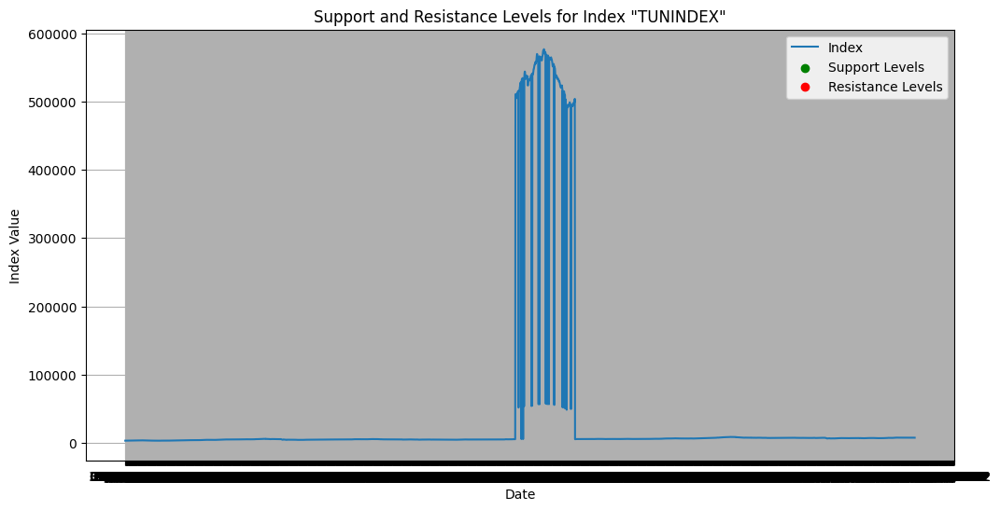

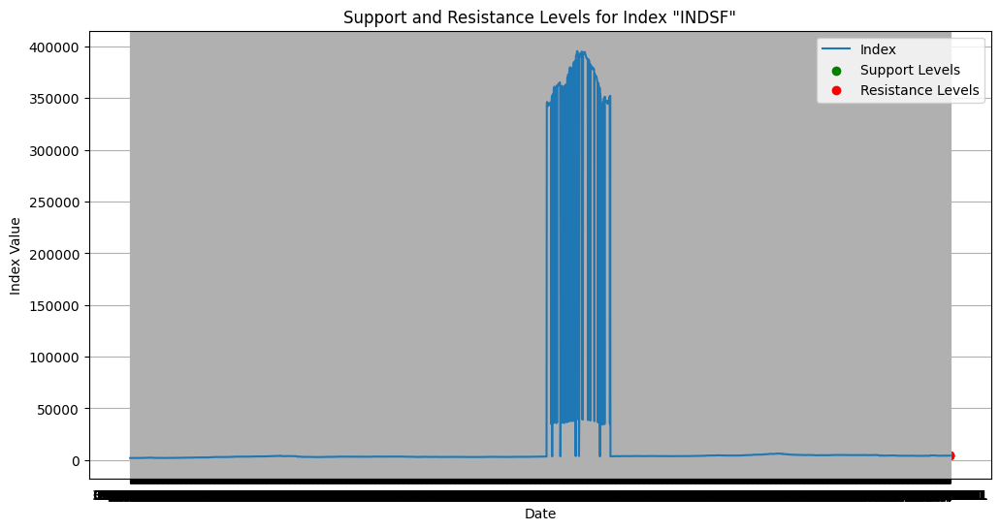

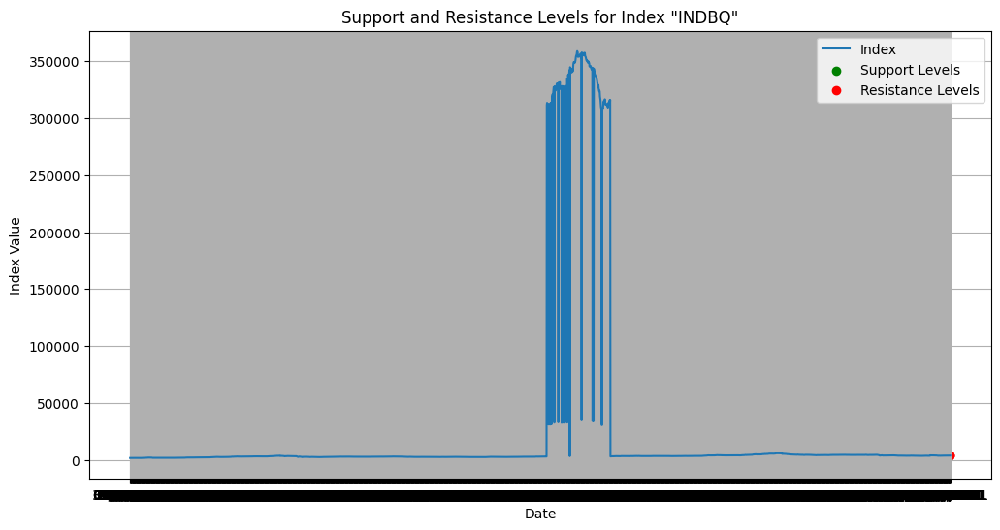

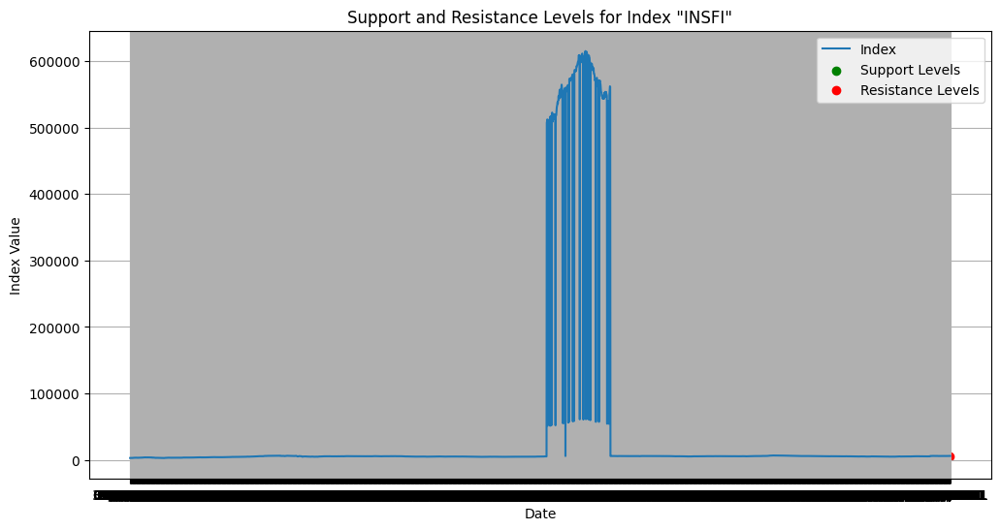

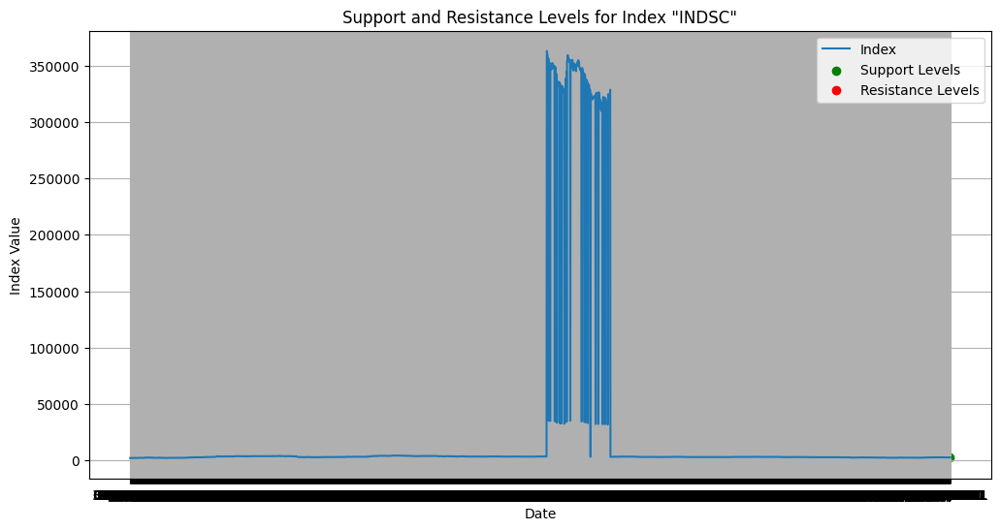

...

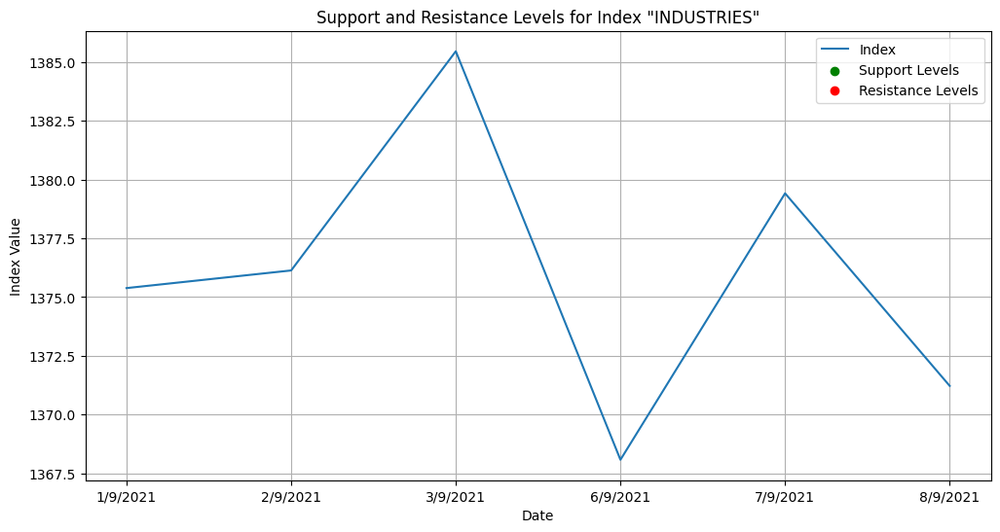

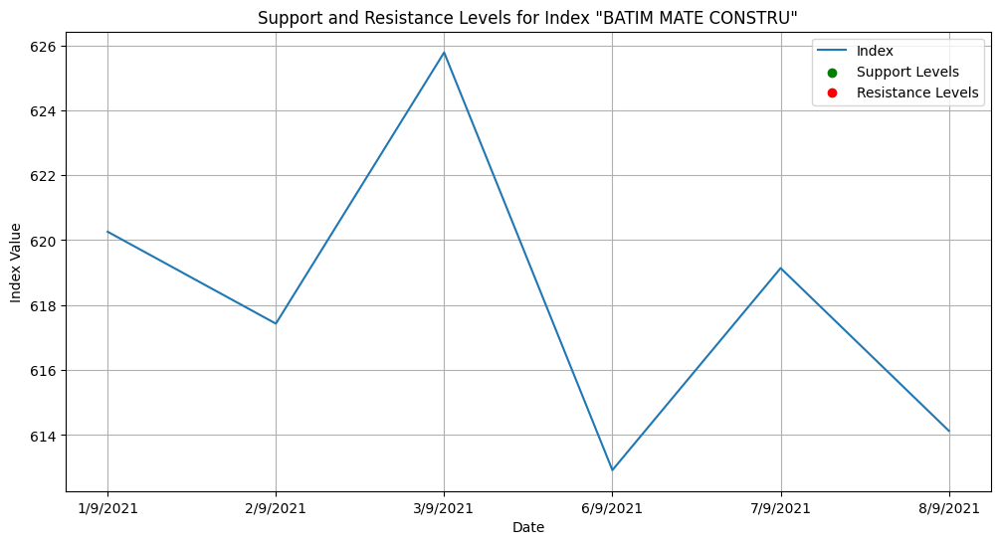

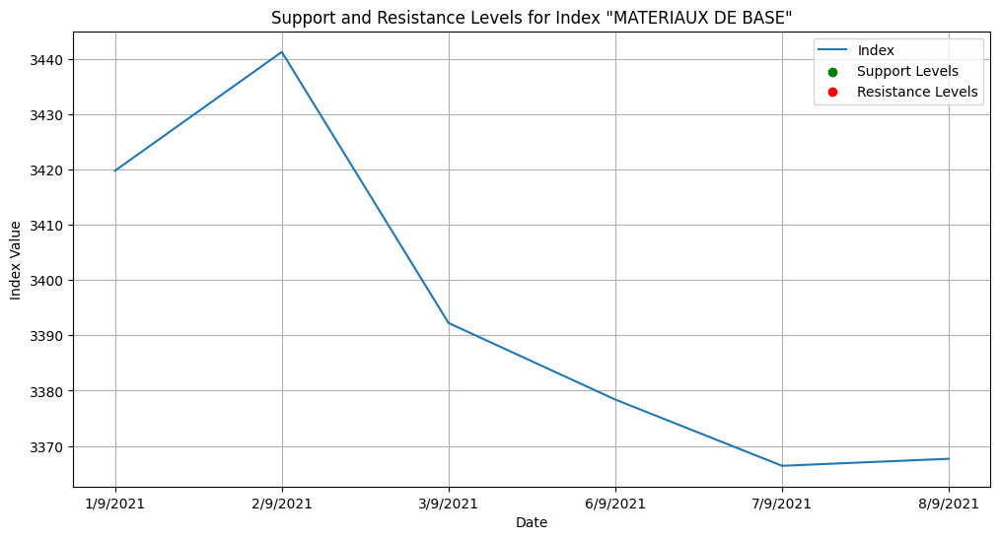

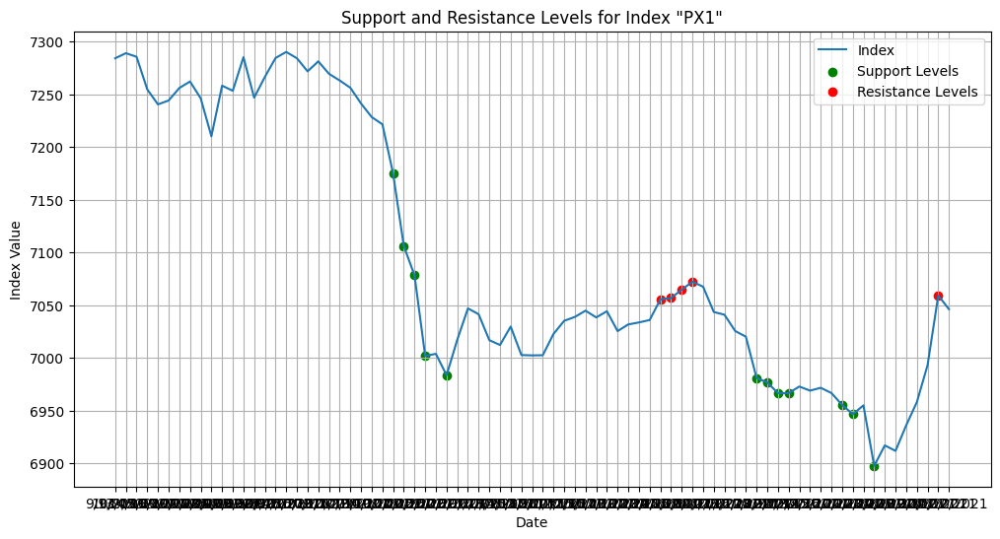

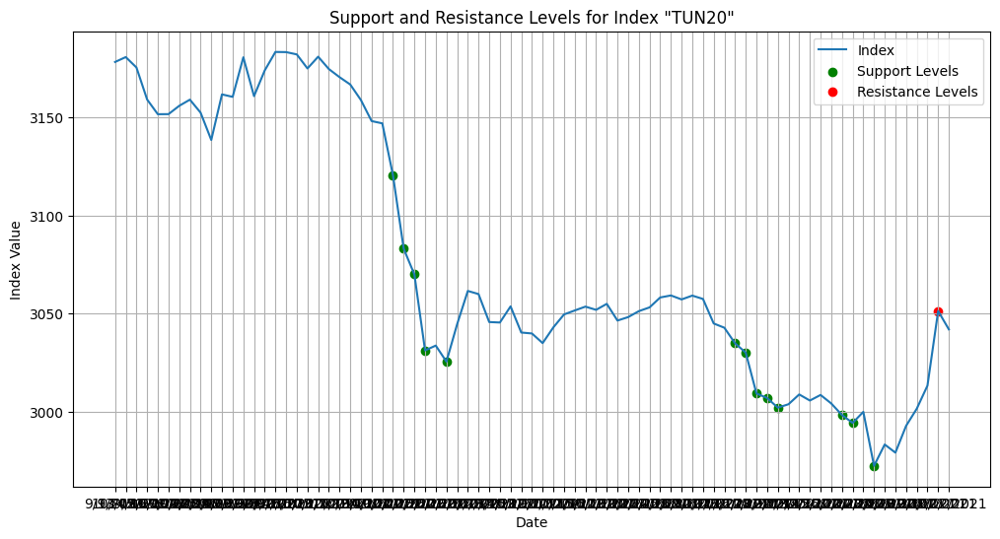

In [ ]:
import matplotlib.pyplot as plt

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Find support and resistance levels for the current index
    support_levels = dataframe.loc[dataframe['Rolling_Low'] == dataframe['Daily_Index'], 'Daily_Index']
    resistance_levels = dataframe.loc[dataframe['Rolling_High'] == dataframe['Daily_Index'], 'Daily_Index']

    # Plot support and resistance levels for the current index
    plt.figure(figsize=(12, 6))
    plt.plot(dataframe['Date'], dataframe['Daily_Index'], label='Index')
    plt.scatter(support_levels.index, support_levels.values, color='green', label='Support Levels')
    plt.scatter(resistance_levels.index, resistance_levels.values, color='red', label='Resistance Levels')
    plt.title(f'Support and Resistance Levels for Index "{index_name}"')
    plt.xlabel('Date')
    plt.ylabel('Index Value')
    plt.legend()
    plt.grid(True)
    plt.show()


Refinement and Validation:
Validate the identified support and resistance levels by observing how the price reacts around these levels in subsequent price movements.
Refine the analysis by adjusting parameters such as the window length for identifying local highs and lows or incorporating additional criteria for defining support and resistance levels.

### Visualize index performance and technical indicators over time to identify profitable trading opportunities and optimize entry and exit points.

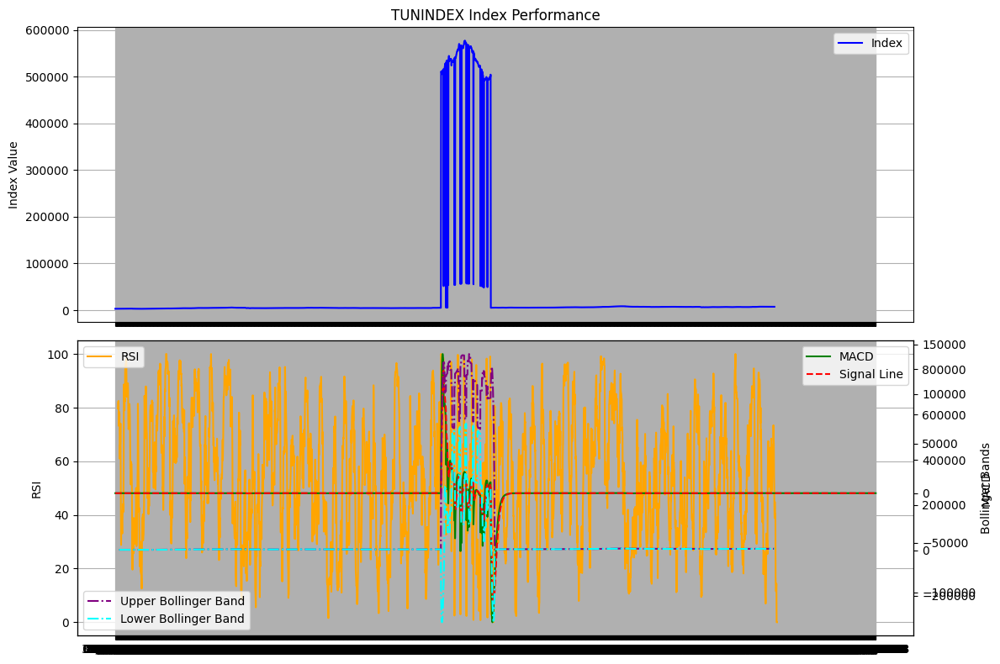

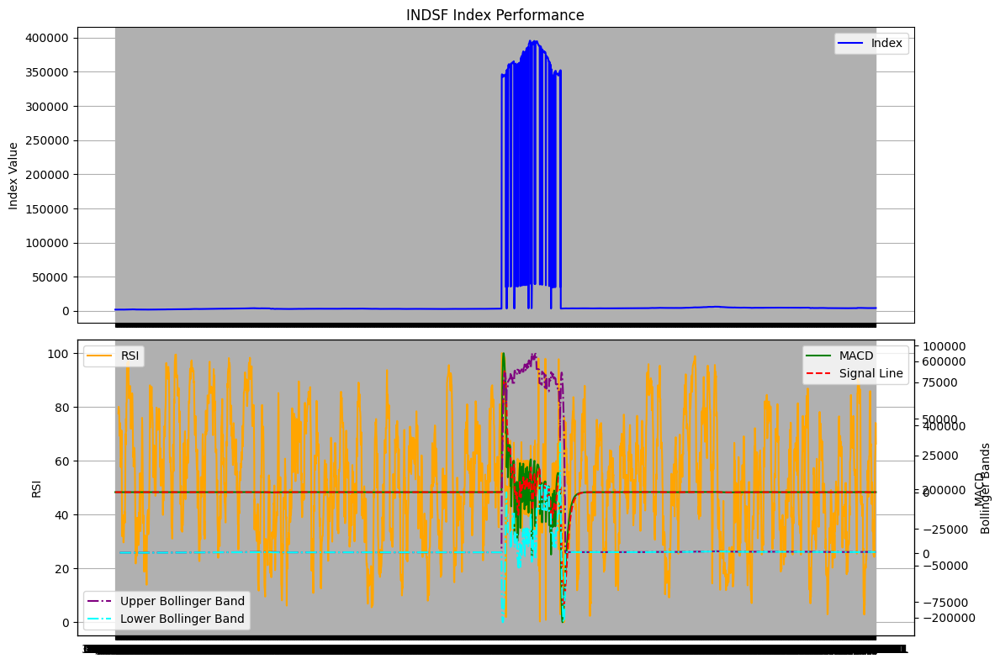

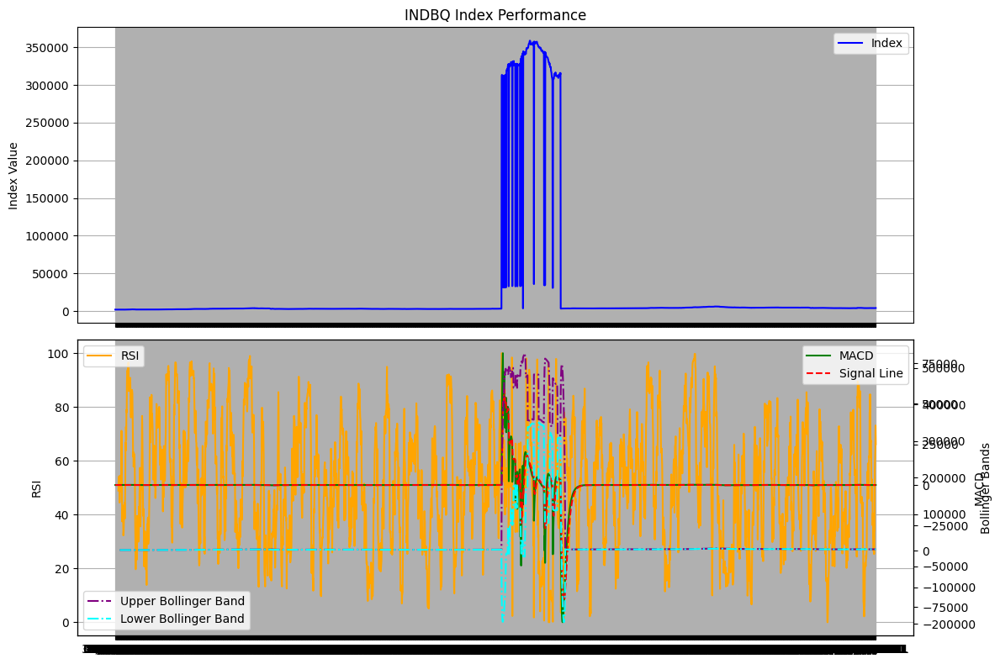

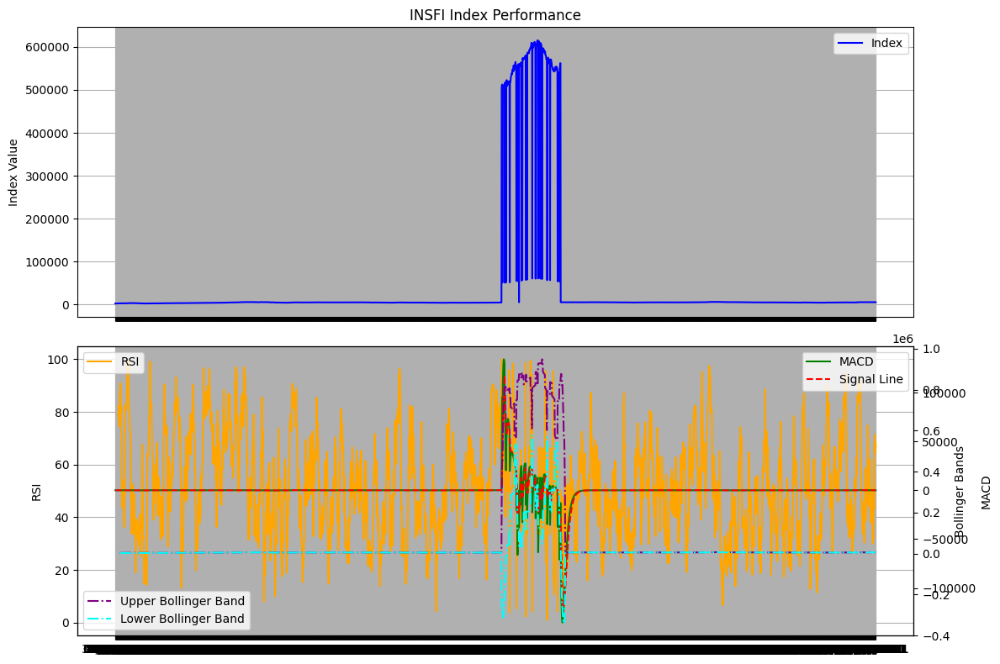

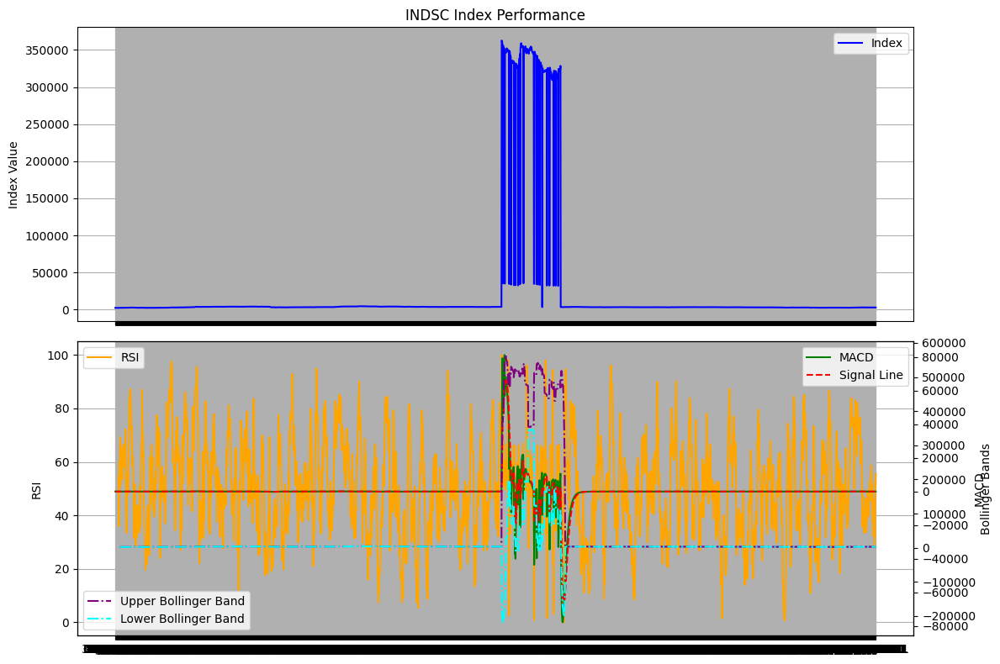

...

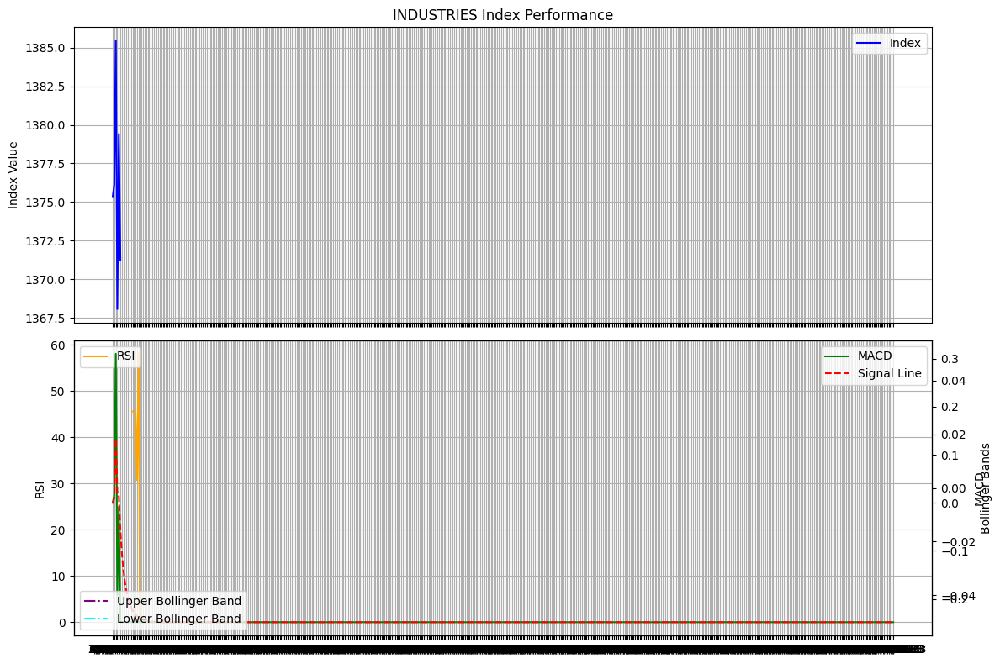

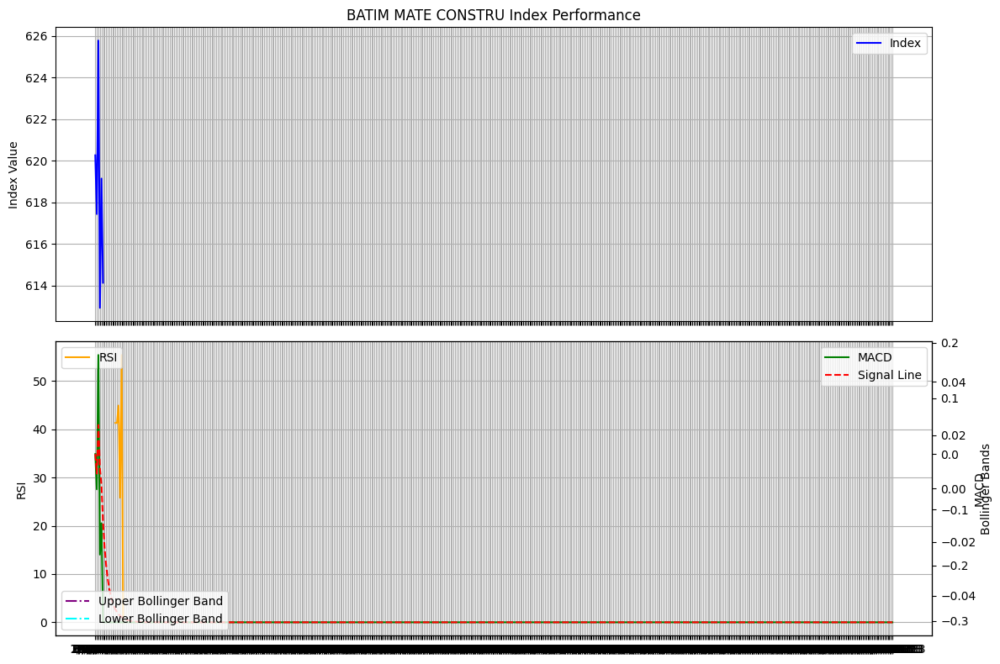

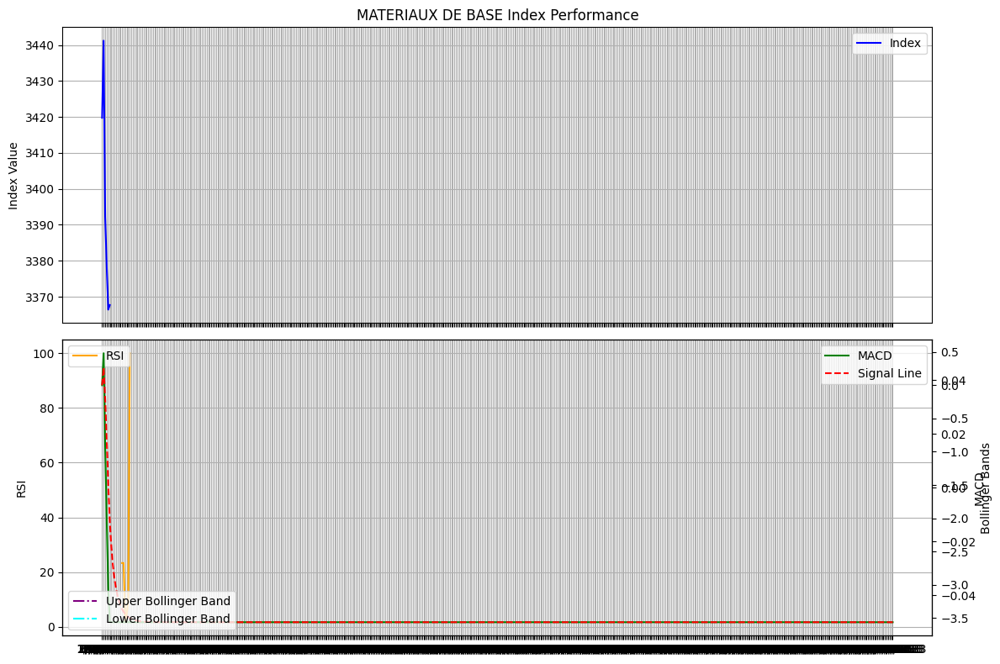

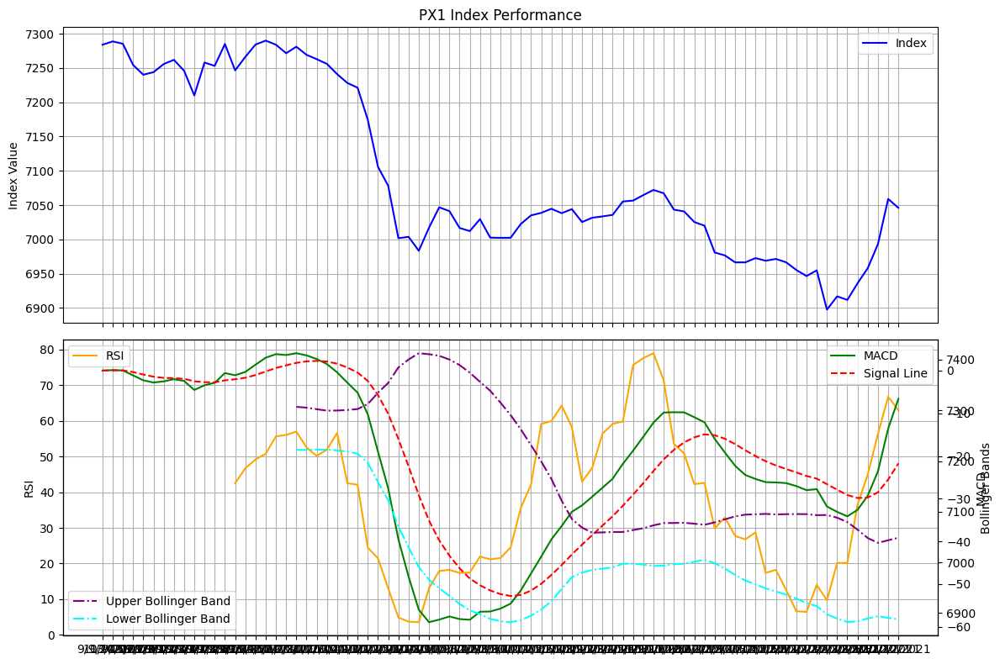

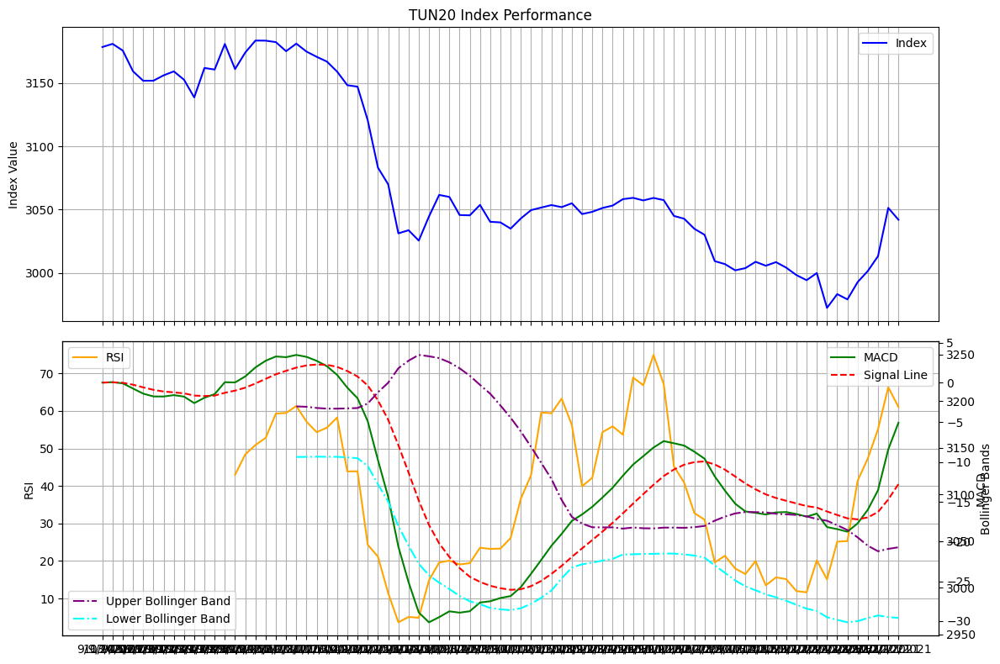

In [ ]:
import matplotlib.pyplot as plt

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Create a figure and subplots
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(12, 8), sharex=True)

    # Plot Index Performance
    axes[0].plot(dataframe['Date'], dataframe['Daily_Index'], label='Index', color='blue')
    axes[0].set_title(f'{index_name} Index Performance')
    axes[0].set_ylabel('Index Value')
    axes[0].grid(True)
    axes[0].legend()

    # Plot Technical Indicators
    axes[1].plot(dataframe['Date'], dataframe['RSI'], label='RSI', color='orange')
    axes[1].set_ylabel('RSI')
    axes[1].grid(True)
    axes[1].legend(loc='upper left')

    # Add MACD and Signal line
    axes_macd = axes[1].twinx()
    axes_macd.plot(dataframe['Date'], dataframe['MACD'], label='MACD', color='green')
    axes_macd.plot(dataframe['Date'], dataframe['Signal'], label='Signal Line', linestyle='--', color='red')
    axes_macd.set_ylabel('MACD')
    axes_macd.legend(loc='upper right')

    # Add Bollinger Bands
    axes_bollinger = axes[1].twinx()
    axes_bollinger.plot(dataframe['Date'], dataframe['Bollinger_Upper'], label='Upper Bollinger Band', linestyle='-.', color='purple')
    axes_bollinger.plot(dataframe['Date'], dataframe['Bollinger_Lower'], label='Lower Bollinger Band', linestyle='-.', color='cyan')
    axes_bollinger.set_ylabel('Bollinger Bands')
    axes_bollinger.legend(loc='lower left')

    # Adjust layout
    plt.tight_layout()
    plt.xlabel('Date')

    # Show the plot for the current index
    plt.show()


# Efficient Trading Operations:




Analyze index volatility and trading volume to optimize trade execution strategies and minimize slippage.

In [ ]:
# Initialize dictionaries to store daily returns and volatility for each index
daily_returns_dict = {}
volatility_dict = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate daily returns
    dataframe['Daily_Returns'] = dataframe['Daily_Index'].pct_change()

    # Calculate volatility (standard deviation of returns)
    volatility = dataframe['Daily_Returns'].std()

    # Store daily returns and volatility in the respective dictionaries
    daily_returns_dict[index_name] = dataframe['Daily_Returns']
    volatility_dict[index_name] = volatility

# Print daily returns and volatility for each index
for index_name, returns in daily_returns_dict.items():
    print(f"Daily Returns for index '{index_name}':")
    print(returns.head())

for index_name, volatility in volatility_dict.items():
    print(f"Volatility for index '{index_name}': {volatility}")


Daily Returns for index 'TUNINDEX':
0         NaN
1    0.001457
2    0.000219
3    0.001671
4    0.006982
Name: Daily_Returns, dtype: float64
Daily Returns for index 'INDSF':
0         NaN
1    0.003614
2    0.001828
3    0.000950
4    0.008880
Name: Daily_Returns, dtype: float64
Daily Returns for index 'INDBQ':
0         NaN
1    0.002974
2    0.001116
3   -0.000318
4    0.009056
Name: Daily_Returns, dtype: float64
Daily Returns for index 'INSFI':
0         NaN
1    0.021812
2    0.004676
3    0.003136
4   -0.008458
Name: Daily_Returns, dtype: float64
Daily Returns for index 'INDSC':
0         NaN
1    0.011098
2   -0.011017
3    0.001023
4    0.002340
Name: Daily_Returns, dtype: float64
Daily Returns for index 'INBCO':
0         NaN
1   -0.011801
2   -0.000528
3    0.001277
4    0.004075
Name: Daily_Returns, dtype: float64
Daily Returns for index 'INAUE':
0         NaN
1    0.031328
2   -0.012111
3    0.006657
4   -0.007792
Name: Daily_Returns, dtype: float64
Daily Returns for index 

In [ ]:
# Analyze Trading Volume:
# Evaluate trading volume to assess market liquidity and participation.
# Higher trading


Monitor index liquidity and market depth to ensure efficient order placement and execution.

Index Liquidity Analysis:
Calculate metrics such as average daily trading volume (ADTV) and bid-ask spread to evaluate index liquidity.
ADTV provides an estimate of the average trading volume over a specific period, indicating the level of market activity.
Bid-ask spread measures the difference between the highest price a buyer is willing to pay (bid) and the lowest price a seller is willing to accept (ask). A narrow spread indicates higher liquidity.

In [ ]:
# Initialize dictionaries to store ADTV and average bid-ask spread for each index
adtv_dict = {}
bid_ask_spread_dict = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Check if 'Volume', 'Highest_Index', and 'Lowest_Index' columns exist in the dataframe
    if 'Volume' in dataframe.columns and 'Highest_Index' in dataframe.columns and 'Lowest_Index' in dataframe.columns:
        # Convert columns to numeric if they contain string data
        dataframe['Volume'] = pd.to_numeric(dataframe['Volume'], errors='coerce')
        dataframe['Highest_Index'] = pd.to_numeric(dataframe['Highest_Index'], errors='coerce')
        dataframe['Lowest_Index'] = pd.to_numeric(dataframe['Lowest_Index'], errors='coerce')

        # Calculate Average Daily Trading Volume (ADTV)
        adtv = dataframe['Volume'].mean()

        # Calculate Bid-Ask Spread
        bid_ask_spread = dataframe['Highest_Index'] - dataframe['Lowest_Index']
        average_spread = bid_ask_spread.mean()

        # Store ADTV and average bid-ask spread in the respective dictionaries
        adtv_dict[index_name] = adtv
        bid_ask_spread_dict[index_name] = average_spread
    else:
        adtv_dict[index_name] = None
        bid_ask_spread_dict[index_name] = None

# Print ADTV and average bid-ask spread for each index
for index_name, adtv in adtv_dict.items():
    print(f"Average Daily Trading Volume (ADTV) for index '{index_name}': {adtv}")

for index_name, spread in bid_ask_spread_dict.items():
    print(f"Average Bid-Ask Spread for index '{index_name}': {spread}")


Average Daily Trading Volume (ADTV) for index 'TUNINDEX': None
Average Daily Trading Volume (ADTV) for index 'INDSF': None
Average Daily Trading Volume (ADTV) for index 'INDBQ': None
Average Daily Trading Volume (ADTV) for index 'INSFI': None
Average Daily Trading Volume (ADTV) for index 'INDSC': None
Average Daily Trading Volume (ADTV) for index 'INBCO': None
Average Daily Trading Volume (ADTV) for index 'INAUE': None
Average Daily Trading Volume (ADTV) for index 'INDIN': None
Average Daily Trading Volume (ADTV) for index 'INBMC': None
Average Daily Trading Volume (ADTV) for index 'INDMB': None
Average Daily Trading Volume (ADTV) for index 'INDDI': None
Average Daily Trading Volume (ADTV) for index 'INDAS': None
Average Daily Trading Volume (ADTV) for index 'INAAB': None
Average Daily Trading Volume (ADTV) for index 'TUNINDEX20': None
Average Daily Trading Volume (ADTV) for index 'INPMP': None
Average Daily Trading Volume (ADTV) for index 'TUNFIN': None
Average Daily Trading Volume (A

Market Depth Analysis:
Assess the depth of the market by analyzing the order book, which contains pending buy and sell orders at various price levels.
Look at the order book to determine the quantity of buy and sell orders at different price levels. A deep order book indicates high market depth.
Use metrics like order book depth or order book imbalance to quantify market depth

In [ ]:
# Initialize dictionaries to store order book depth for each index
order_book_depth_dict = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Example: Get buy and sell orders for the current index (You should replace this with your actual implementation)
    buy_orders = get_buy_orders(dataframe)
    sell_orders = get_sell_orders(dataframe)

    # Calculate total buy and sell quantities
    total_buy_quantity = sum(buy_orders.values())
    total_sell_quantity = sum(sell_orders.values())

    # Calculate order book depth
    order_book_depth = min(total_buy_quantity, total_sell_quantity)

    # Store order book depth in the dictionary
    order_book_depth_dict[index_name] = order_book_depth

# Print order book depth for each index
for index_name, depth in order_book_depth_dict.items():
    print(f"Order Book Depth for index '{index_name}': {depth}")


changes in liquidity metrics over different time periods.

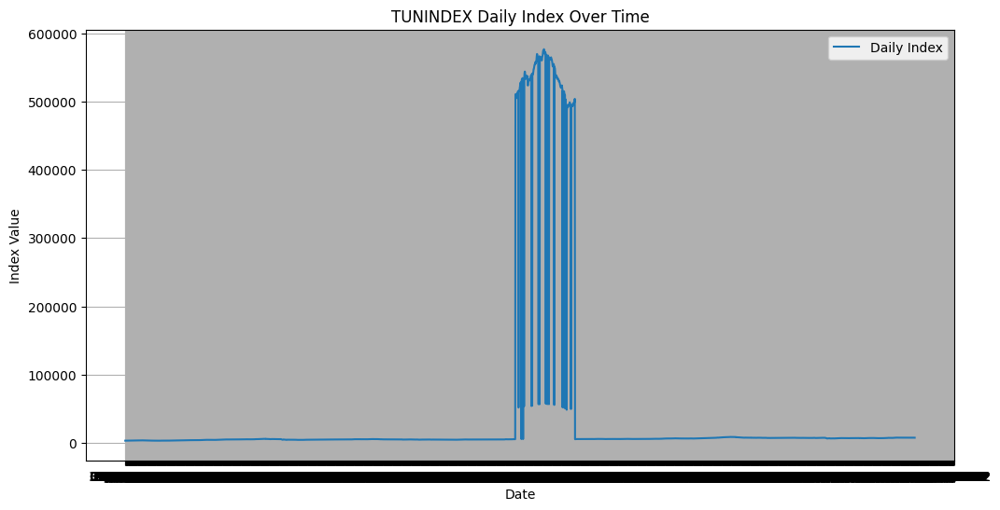

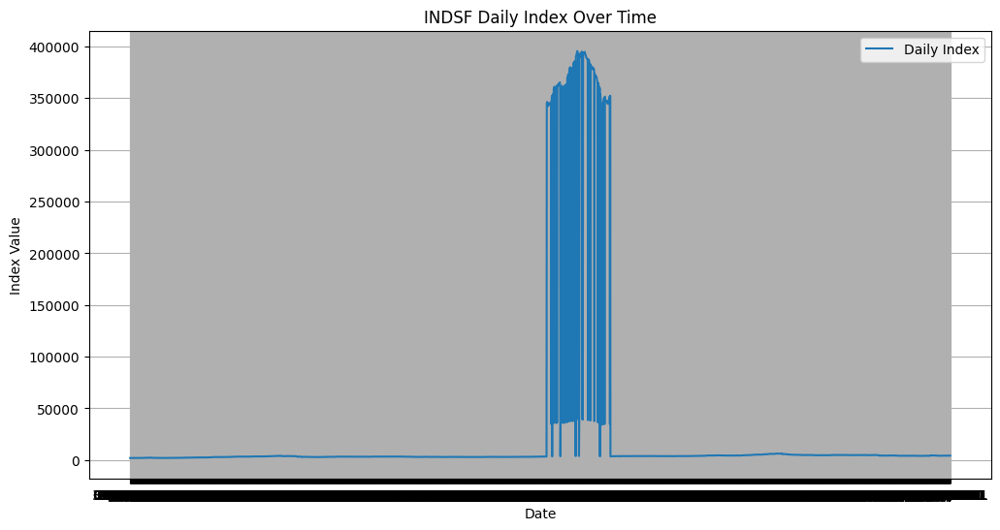

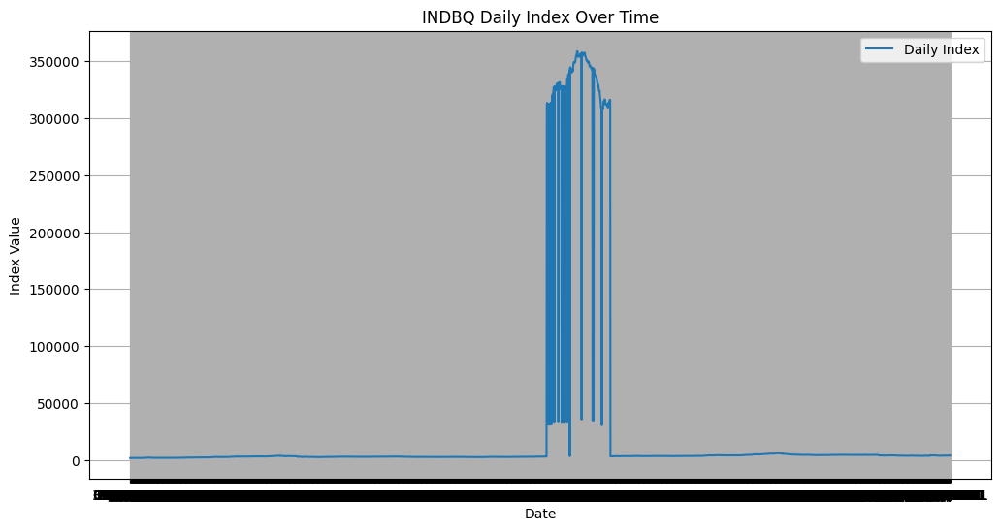

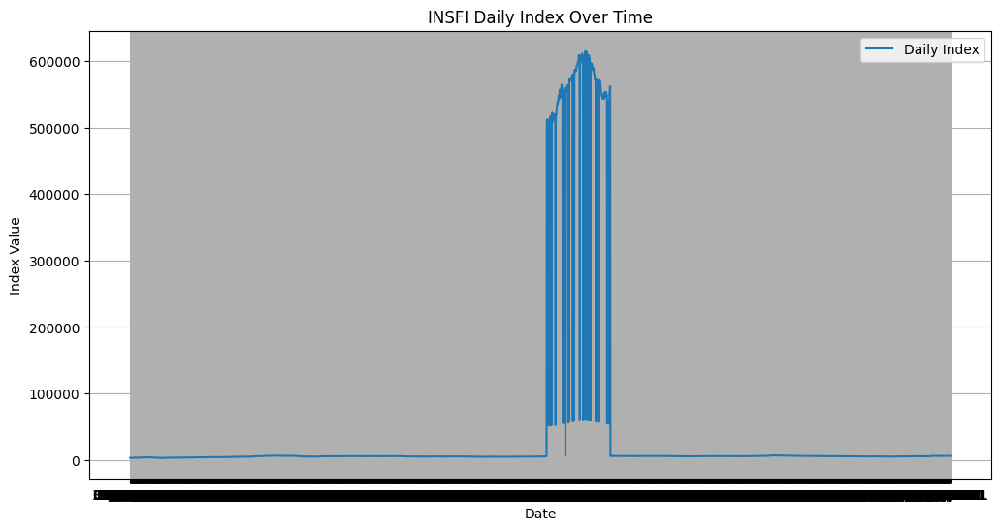

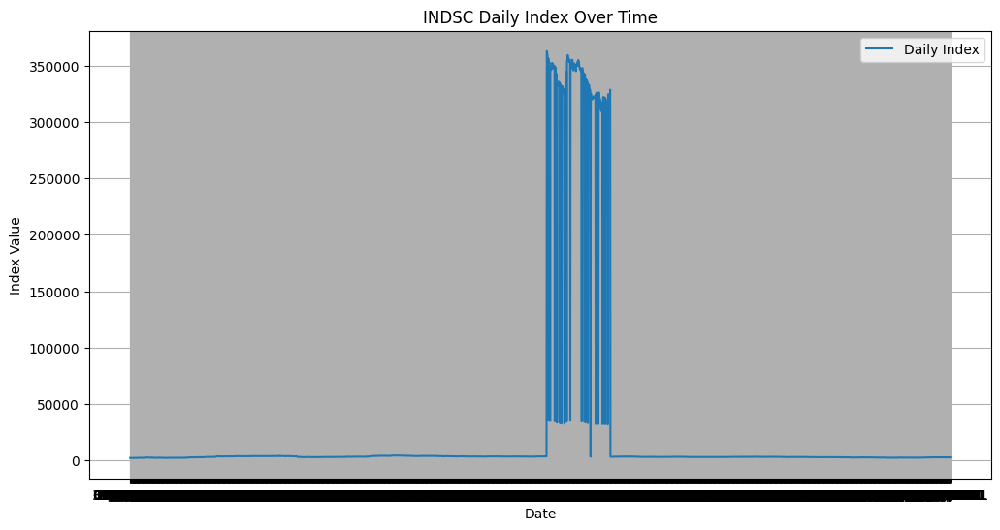

...

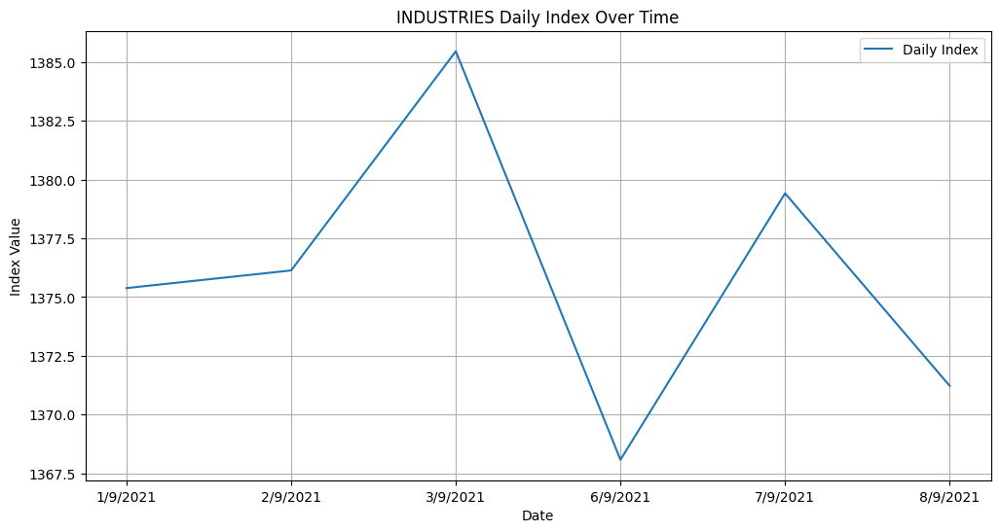

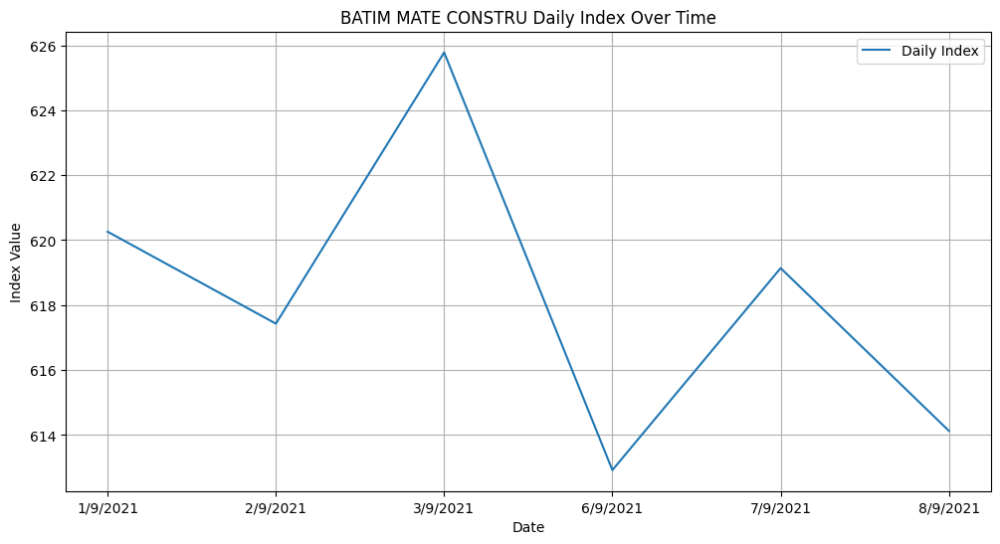

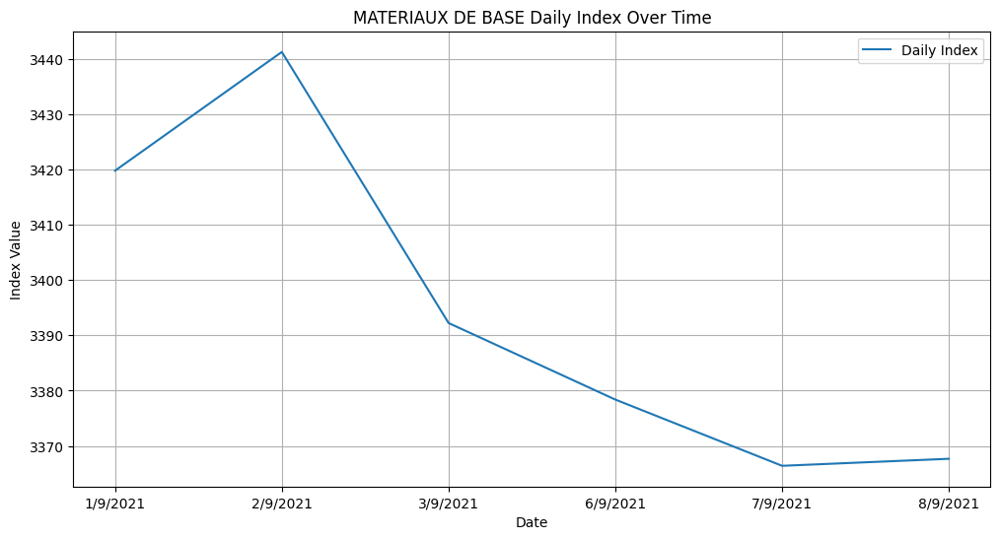

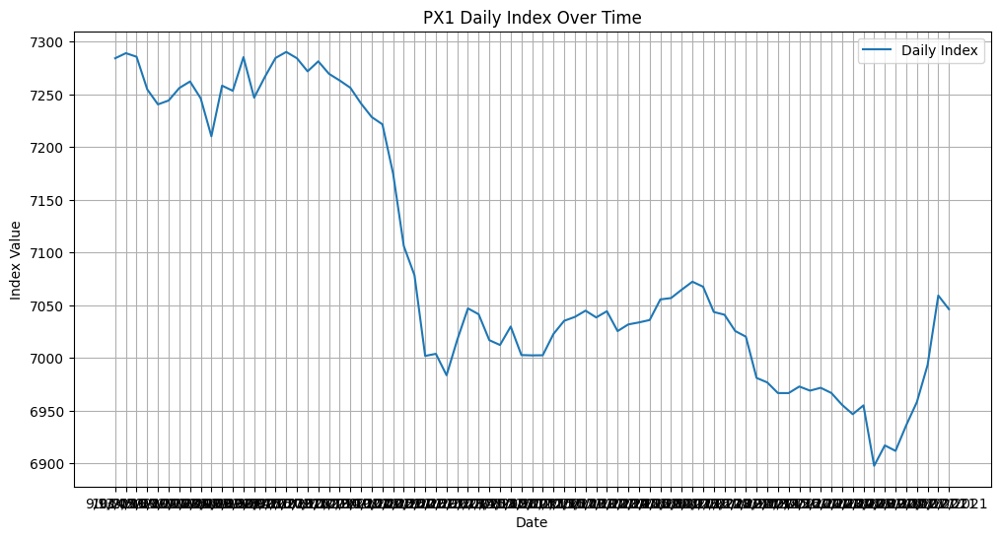

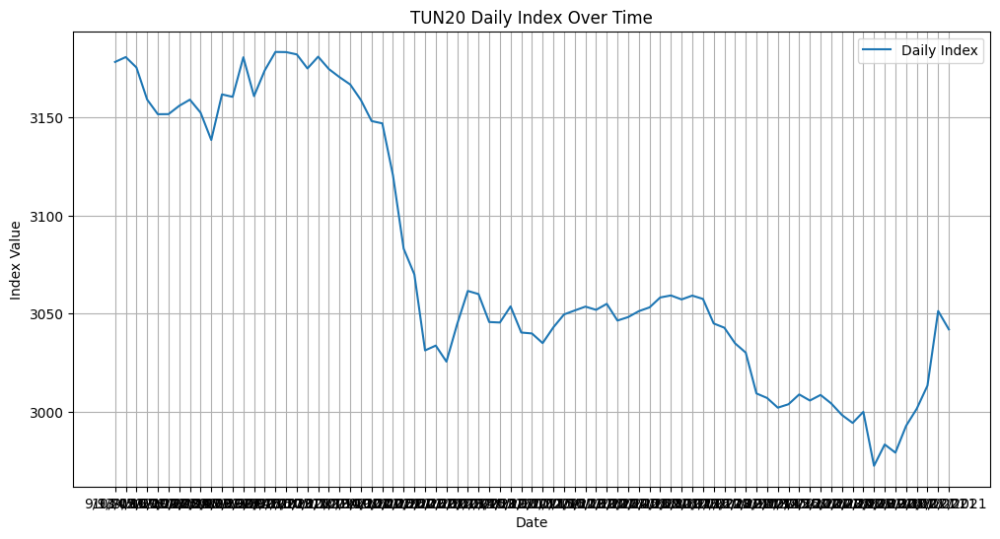

In [ ]:
import matplotlib.pyplot as plt

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Check if the desired column exists in the dataframe
    if 'Daily_Index' in dataframe.columns:
        # Plot the desired data for the current index
        plt.figure(figsize=(12, 6))
        plt.plot(dataframe['Date'], dataframe['Daily_Index'], label='Daily Index')
        plt.title(f'{index_name} Daily Index Over Time')
        plt.xlabel('Date')
        plt.ylabel('Index Value')
        plt.legend()
        plt.grid(True)
        plt.show()
    else:
        print(f"Desired data not available for index '{index_name}'.")



### Visualize trading metrics such as trading volume, volatility, and liquidity trends to identify patterns and optimize trading operations.

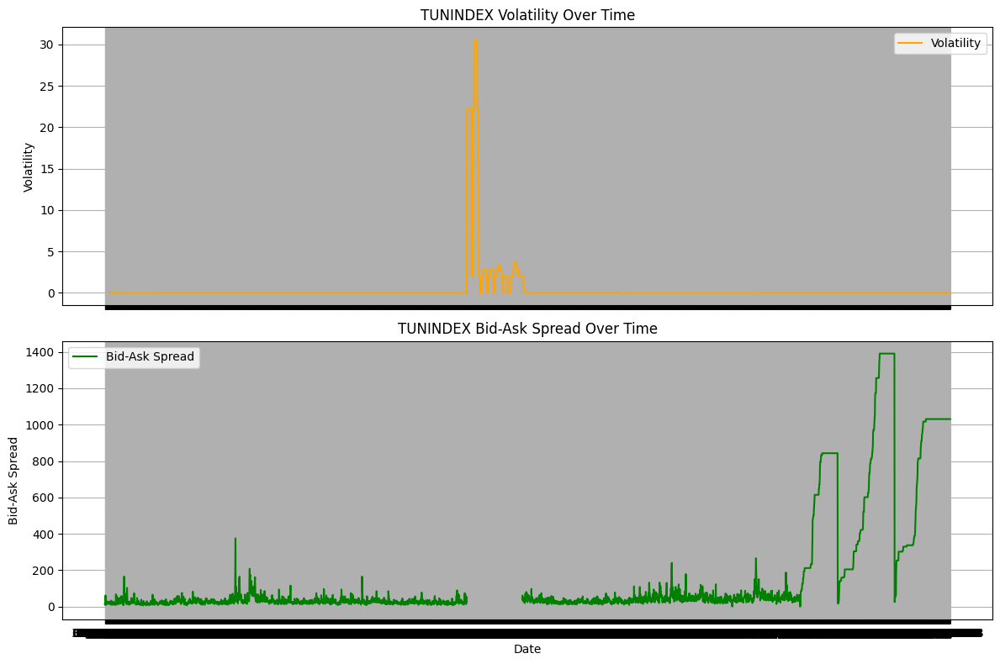

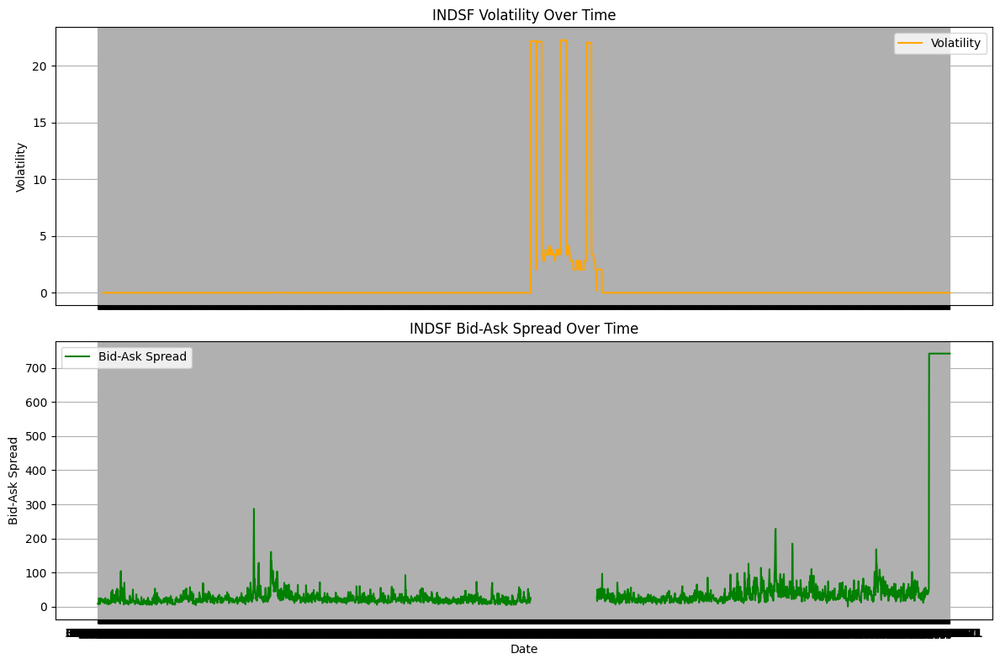

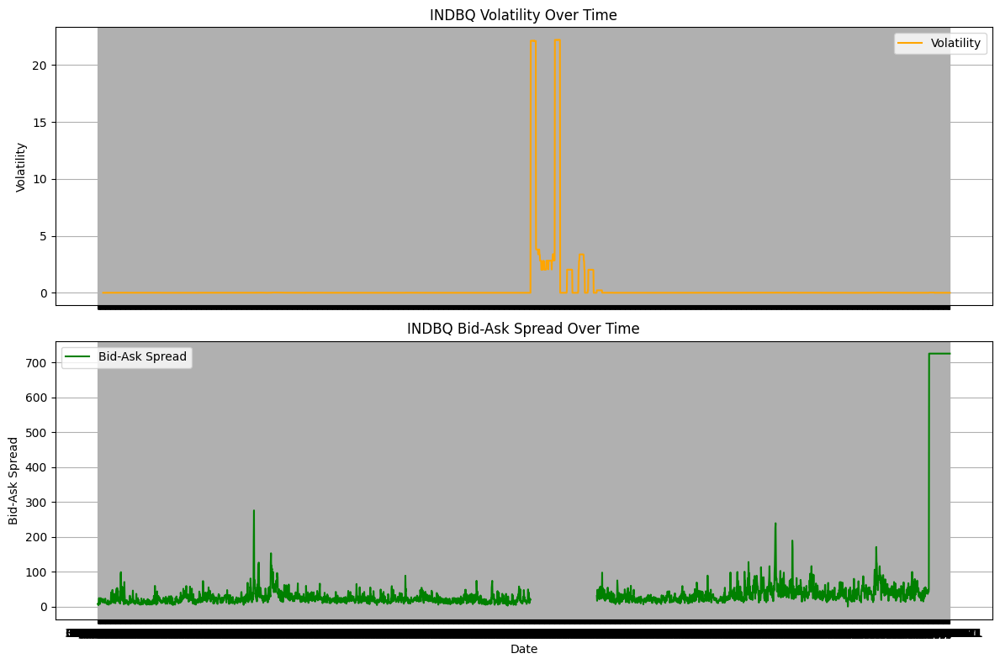

TypeError: unsupported operand type(s) for -: 'str' and 'str'

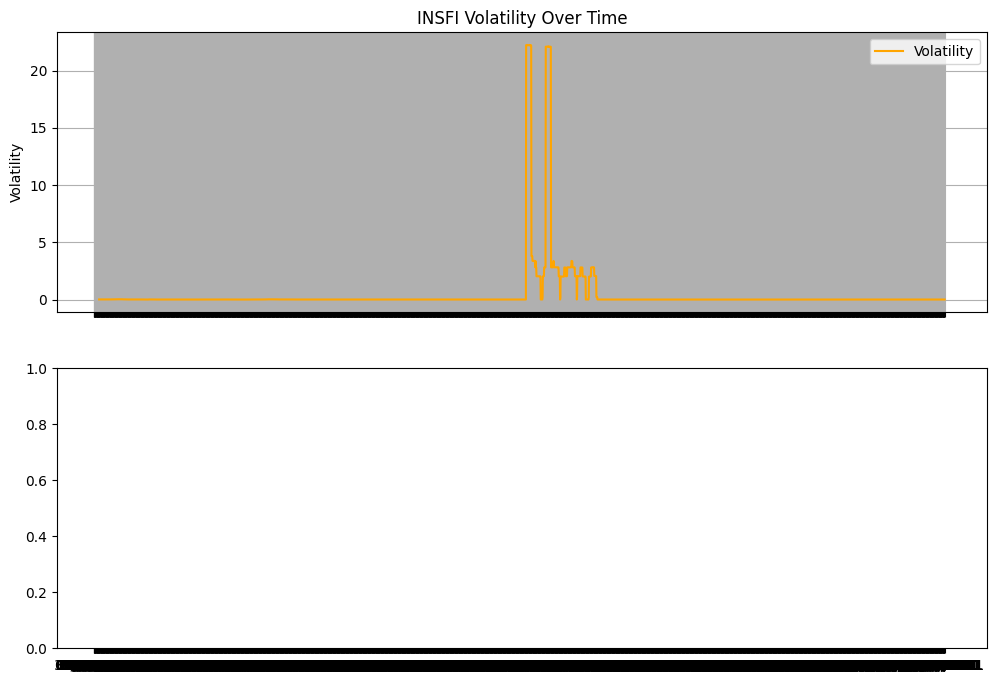

In [ ]:
import matplotlib.pyplot as plt
# Convert 'Highest_Index' and 'Lowest_Index' columns to numerical data types
# Replace non-numeric values with NaN in 'Highest_Index' and 'Lowest_Index' columns
dataframe['Highest_Index'] = pd.to_numeric(dataframe['Highest_Index'], errors='coerce')
dataframe['Lowest_Index'] = pd.to_numeric(dataframe['Lowest_Index'], errors='coerce')

# Drop rows with NaN values
dataframe = dataframe.dropna(subset=['Highest_Index', 'Lowest_Index'])

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Create a figure and subplots
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(12, 8), sharex=True)

    # Plot volatility (standard deviation of returns)
    axes[0].plot(dataframe['Date'], dataframe['Daily_Returns'].rolling(window=20).std(), label='Volatility', color='orange')
    axes[0].set_title(f'{index_name} Volatility Over Time')
    axes[0].set_ylabel('Volatility')
    axes[0].grid(True)
    axes[0].legend()

    # Plot liquidity (average bid-ask spread)
    axes[1].plot(dataframe['Date'], dataframe['Highest_Index'] - dataframe['Lowest_Index'], label='Bid-Ask Spread', color='green')
    axes[1].set_title(f'{index_name} Bid-Ask Spread Over Time')
    axes[1].set_ylabel('Bid-Ask Spread')
    axes[1].grid(True)
    axes[1].legend()

    # Adjust layout
    plt.xlabel('Date')
    plt.tight_layout()
    plt.show()


# Diversify Trading Strategies:






Explore different index trading strategies such as trend-following, mean reversion, and volatility breakout using historical index data.

Trend-Following Strategy:
Trend-following strategies aim to capitalize on sustained price movements in the same direction as the prevailing trend.
One common approach is to use moving averages to identify trends. For example, buying when the short-term moving average crosses above the long-term moving average (golden cross) and selling when the opposite occurs (death cross).

In [ ]:
# Define short and long windows for the moving averages
short_window = 50
long_window = 200

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate short and long SMAs
    dataframe['SMA_short'] = dataframe['Daily_Index'].rolling(window=short_window).mean()
    dataframe['SMA_long'] = dataframe['Daily_Index'].rolling(window=long_window).mean()

    # Generate signals
    dataframe['Signal'] = 0
    dataframe.loc[dataframe['SMA_short'] > dataframe['SMA_long'], 'Signal'] = 1  # Buy signal
    dataframe.loc[dataframe['SMA_short'] < dataframe['SMA_long'], 'Signal'] = -1  # Sell signal

    # Calculate returns
    dataframe['Returns'] = dataframe['Daily_Index'].pct_change()
    dataframe['Strategy_Returns'] = dataframe['Signal'].shift(1) * dataframe['Returns']


Mean Reversion Strategy:
Mean reversion strategies aim to profit from price movements that revert back to their historical mean or average.
One approach is to identify overbought or oversold conditions using indicators like RSI or Bollinger Bands and trade in the opposite direction when the price deviates significantly from the mean.

In [ ]:
# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate Bollinger Bands
    rolling_mean, upper_band, lower_band = calculate_bollinger_bands(dataframe['Daily_Index'])

    # Generate signals
    dataframe['Signal'] = 0
    dataframe.loc[dataframe['Daily_Index'] > upper_band, 'Signal'] = -1  # Sell signal
    dataframe.loc[dataframe['Daily_Index'] < lower_band, 'Signal'] = 1  # Buy signal

    # Calculate returns
    dataframe['Strategy_Returns'] = dataframe['Signal'].shift(1) * dataframe['Returns']



Volatility Breakout Strategy:
Volatility breakout strategies aim to capitalize on significant price movements following periods of low volatility.
One approach is to identify periods of low volatility using indicators like the average true range (ATR) and enter trades when the price breaks out above or below recent trading ranges.

In [ ]:
def calculate_atr(high, low, close, window=14):
    """
    Calculate Average True Range (ATR)
    """
    # Convert columns to numeric
    high = pd.to_numeric(high, errors='coerce')
    low = pd.to_numeric(low, errors='coerce')
    close = pd.to_numeric(close, errors='coerce')

    tr = pd.Series(index=high.index)  # Create an empty Series to store True Range values
    tr[0] = high.iloc[0] - low.iloc[0]  # Initialize the first True Range value

    # Loop through the DataFrame to calculate True Range
    for i in range(1, len(high)):
        tr[i] = max(high.iloc[i] - low.iloc[i], abs(high.iloc[i] - close.iloc[i - 1]), abs(low.iloc[i] - close.iloc[i - 1]))

    atr = tr.rolling(window=window).mean()
    return atr


In [ ]:
# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate Average True Range (ATR)
    window = 14
    average_true_range = calculate_atr(dataframe['Highest_Index'], dataframe['Lowest_Index'], dataframe['Daily_Index'], window)

    # Generate signals
    dataframe['Signal'] = 0
    dataframe.loc[dataframe['Daily_Index'] > dataframe['Daily_Index'].shift(1) + 1.5 * average_true_range, 'Signal'] = 1  # Buy signal
    dataframe.loc[dataframe['Daily_Index'] < dataframe['Daily_Index'].shift(1) - 1.5 * average_true_range, 'Signal'] = -1  # Sell signal

    # Calculate returns
    dataframe['Strategy_Returns'] = dataframe['Signal'].shift(1) * dataframe['Returns']


<ipython-input-99-ffe1cfd1e2bc>:10: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  tr = pd.Series(index=high.index)  # Create an empty Series to store True Range values


Backtesting and Evaluation:
Backtest each trading strategy using historical index data to evaluate its performance in terms of returns, risk-adjusted returns, and other relevant metrics.
Compare the results of different strategies and select the one that best fits your trading objectives and risk tolerance.

In [ ]:
# Initialize dictionaries to store cumulative returns for each index
cumulative_returns_dict = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Extract strategy returns and drop NaN values
    strategy_returns = dataframe['Strategy_Returns'].dropna()

    # Calculate cumulative returns
    cumulative_returns = (1 + strategy_returns).cumprod()

    # Store cumulative returns in the dictionary
    cumulative_returns_dict[index_name] = cumulative_returns

# Print cumulative returns for each index
for index_name, cumulative_returns in cumulative_returns_dict.items():
    print(f"Cumulative Returns for index '{index_name}':")
    print(cumulative_returns.head())


Cumulative Returns for index 'TUNINDEX':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INDSF':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INDBQ':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INSFI':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INDSC':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INBCO':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INAUE':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns for index 'INDIN':
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
Name: Strategy_Returns, dtype: float64
Cumulative Returns fo

### Incorporate index correlations and intermarket analysis to diversify trading strategies across different asset classes.

Understand Index Correlations:
Calculate correlation coefficients between the returns of various indices representing different asset classes.
Positive correlations imply that the indices move in the same direction, while negative correlations imply they move in opposite directions.

In [ ]:
# Initialize a dictionary to store correlation matrices for each index
correlation_matrices = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate the correlation matrix
    correlation_matrix = dataframe.corr()

    # Store the correlation matrix in the dictionary
    correlation_matrices[index_name] = correlation_matrix

# Print correlation matrices for each index
for index_name, correlation_matrix in correlation_matrices.items():
    print(f"Correlation Matrix for index '{index_name}':")
    print(correlation_matrix)


<ipython-input-104-feaf12e56199>:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = dataframe.corr()


Correlation Matrix for index 'TUNINDEX':
                  Daily_Index  Highest_Index  Lowest_Index  Unnamed: 9  \
Daily_Index          1.000000       0.129501      0.068656         NaN   
Highest_Index        0.129501       1.000000      0.984810         NaN   
Lowest_Index         0.068656       0.984810      1.000000         NaN   
Unnamed: 9                NaN            NaN           NaN         NaN   
RSI                 -0.015745      -0.037278     -0.034466         NaN   
MACD                 0.304149       0.033086      0.028624         NaN   
Signal              -0.009577      -0.020323     -0.018531         NaN   
MACD_Histogram       0.125497       0.006433      0.007046         NaN   
Bollinger_Middle     0.942014       0.044372      0.038506         NaN   
Bollinger_Upper      0.918006       0.012891      0.013971         NaN   
Bollinger_Lower      0.742324       0.074740      0.063175         NaN   
Rolling_High         0.933668       0.021924      0.021913         NaN 

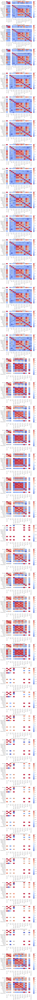

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style of the heatmap
sns.set(style="white")

# Set up the matplotlib figure
fig, axes = plt.subplots(nrows=len(correlation_matrices), figsize=(10, 6 * len(correlation_matrices)))

# Loop over each index and its correlation matrix
for i, (index_name, correlation_matrix) in enumerate(correlation_matrices.items()):
    # Create a heatmap for the correlation matrix
    sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt=".2f", linewidths=.5, ax=axes[i])
    axes[i].set_title(f'Correlation Matrix for Index "{index_name}"')

# Adjust layout
plt.tight_layout()
plt.show()


Intermarket Analysis:
Analyze how changes in one market affect other related markets. For example, how changes in interest rates affect bond prices, which in turn influence stock prices.
Look for leading indicators and lagging indicators across different asset classes to identify potential trading opportunities.

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd

# Initialize dictionaries to store correlation coefficients or regression results for each index
relationship_analysis = {}

# Loop over each dataframe in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Filter stock index returns and bond yield changes for the current index
    stock_index_returns = dataframe['Daily_Returns']
    bond_yield_changes = bond_yield_data[index_name]  # Assuming bond_yield_data contains daily changes for bond yields

    # Check if there are NaN values in the data
    if stock_index_returns.isnull().any() or bond_yield_changes.isnull().any():
        print(f"Missing data for index '{index_name}'. Skipping analysis.")
        continue

    # Calculate correlation coefficient between stock index returns and bond yield changes
    correlation_coefficient = np.corrcoef(stock_index_returns, bond_yield_changes)[0, 1]

    # Store the correlation coefficient in the dictionary
    relationship_analysis[index_name] = correlation_coefficient

# Print correlation coefficients for each index
for index_name, correlation_coefficient in relationship_analysis.items():
    print(f"Correlation coefficient between stock index returns and bond yield changes for index '{index_name}': {correlation_coefficient}")


Diversified Trading Strategies:
Develop trading strategies that take advantage of correlations and intermarket relationships to diversify across asset classes.
For example, if stock indices and commodity prices have a positive correlation, consider a strategy that simultaneously trades stocks and commodities based on signals generated from both markets.

In [ ]:
# Initialize dictionaries to store entry and exit signals for each pair of indices
entry_signals = {}
exit_signals = {}

# Loop over each pair of indices (assuming index_pairs is a list of tuples containing pairs of indices)
for index1_name, index2_name in index_pairs:
    # Extract returns for the current pair of indices
    index1_returns = index_dataframes[index1_name]['Daily_Returns']
    index2_returns = index_dataframes[index2_name]['Daily_Returns']

    # Calculate spread between the returns of the two indices
    spread = index1_returns - index2_returns
    spread_mean = spread.mean()
    spread_std = spread.std()

    # Define entry and exit thresholds
    entry_threshold = spread_mean + 1.5 * spread_std
    exit_threshold = spread_mean

    # Implement entry and exit signals based on spread thresholds
    entry_signals[(index1_name, index2_name)] = spread > entry_threshold
    exit_signals[(index1_name, index2_name)] = spread < exit_threshold

# Print entry and exit signals for each pair of indices
for (index1_name, index2_name), entry_signal in entry_signals.items():
    print(f"Entry signal for pair '{index1_name}' and '{index2_name}':")
    print(entry_signal)

for (index1_name, index2_name), exit_signal in exit_signals.items():
    print(f"Exit signal for pair '{index1_name}' and '{index2_name}':")
    print(exit_signal)


Risk Management:
Implement risk management techniques to control exposure and minimize potential losses in diversified trading strategies.
Consider position sizing, stop-loss orders, and portfolio diversification to manage risk effectively across multiple asset classes.

In [ ]:
# Example: Implement position sizing based on portfolio volatility and correlation structure
# Adjust position sizes in each asset class to achieve desired risk exposure and diversification benefits


Utilize fundamental data such as dividend yields, earnings growth, and economic indicators to complement technical analysis in index trading strategies.

Dividend Yields:
Dividend yields indicate the dividend income generated by an index relative to its price.
High dividend yields may attract investors seeking income, potentially leading to increased demand for the index.
Monitor dividend yield trends and compare them with historical averages to identify potential trading opportunities.

In [ ]:
# Initialize dictionaries to store dividend yield data and analysis results for each index
dividend_yield_analysis = {}

# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Assuming get_dividend_yield_data is a function to retrieve dividend yield data for the index
    dividend_yield_data = get_dividend_yield_data(index_name)

    # Perform analysis
    # For example, you can analyze dividend yield trends and compare with technical analysis signals here

    # Store analysis results in the dividend_yield_analysis dictionary
    dividend_yield_analysis[index_name] = {
        'dividend_yield_data': dividend_yield_data,
        # Add additional analysis results as needed
    }

# Print dividend yield data and analysis results for each index
for index_name, analysis_results in dividend_yield_analysis.items():
    print(f"Dividend Yield Data and Analysis Results for index '{index_name}':")
    print(analysis_results)


NameError: name 'get_dividend_yield_data' is not defined

Earnings Growth:
Earnings growth reflects the rate at which a company's earnings are increasing over time.
Strong earnings growth may signal positive sentiment and potential future price appreciation in the index.
Monitor earnings reports and earnings growth trends to assess the fundamental health of the index constituents.

In [ ]:
# Initialize dictionaries to store earnings growth data and analysis results for each index
earnings_growth_analysis = {}

# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Assuming get_earnings_growth_data is a function to retrieve earnings growth data for the index
    earnings_growth_data = get_earnings_growth_data(index_name)

    # Perform analysis
    # For example, you can analyze earnings growth trends and compare with technical analysis signals here

    # Store analysis results in the earnings_growth_analysis dictionary
    earnings_growth_analysis[index_name] = {
        'earnings_growth_data': earnings_growth_data,
        # Add additional analysis results as needed
    }

# Print earnings growth data and analysis results for each index
for index_name, analysis_results in earnings_growth_analysis.items():
    print(f"Earnings Growth Data and Analysis Results for index '{index_name}':")
    print(analysis_results)


Economic Indicators:
Economic indicators such as GDP growth, inflation rates, unemployment rates, and consumer confidence can impact overall market sentiment and index performance.
Monitor key economic releases and their potential impact on the index and its constituents.
Use economic indicators to assess the macroeconomic environment and anticipate potential market trends.

In [ ]:
# Initialize dictionaries to store economic indicators data for each index
economic_indicators_data = {}

# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Assuming get_gdp_growth_data, get_inflation_rate_data, get_unemployment_rate_data, and get_consumer_confidence_data
    # are functions that retrieve the respective economic indicators data for the index
    gdp_growth_data = get_gdp_growth_data(index_name)
    inflation_rate_data = get_inflation_rate_data(index_name)
    unemployment_rate_data = get_unemployment_rate_data(index_name)
    consumer_confidence_data = get_consumer_confidence_data(index_name)

    # Store economic indicators data in the economic_indicators_data dictionary
    economic_indicators_data[index_name] = {
        'gdp_growth': gdp_growth_data,
        'inflation_rate': inflation_rate_data,
        'unemployment_rate': unemployment_rate_data,
        'consumer_confidence': consumer_confidence_data,
        # Add additional economic indicators data as needed
    }

# Print economic indicators data for each index
for index_name, indicators_data in economic_indicators_data.items():
    print(f"Economic Indicators Data for index '{index_name}':")
    print(indicators_data)


Integration with Technical Analysis:
Integrate fundamental data with technical analysis by considering both types of information when making trading decisions.
Look for confluence or divergence between technical signals and fundamental factors to validate trading opportunities.

In [ ]:
# Assuming you have technical signals and dividend yield data for each index
# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Extract technical signals and dividend yield data for the current index
    technical_signal = get_technical_signal(index_name)
    dividend_yield = get_dividend_yield(index_name)
    historical_average_dividend_yield = get_historical_average_dividend_yield(index_name)

    # Combine technical analysis signals with fundamental data in trading strategy rules
    if technical_signal == 'Buy' and dividend_yield > historical_average_dividend_yield:
        # Consider the fundamental strength in addition to the technical signal
        execute_buy_trade(index_name)  # Execute buy trade for the current index


### Visualize index correlations, sector rotation, and fundamental data trends to identify diversification opportunities and optimize portfolio allocation.

Visualize index correlations, sector rotation, and fundamental data trends to identify diversification opportunities and optimize portfolio allocation.

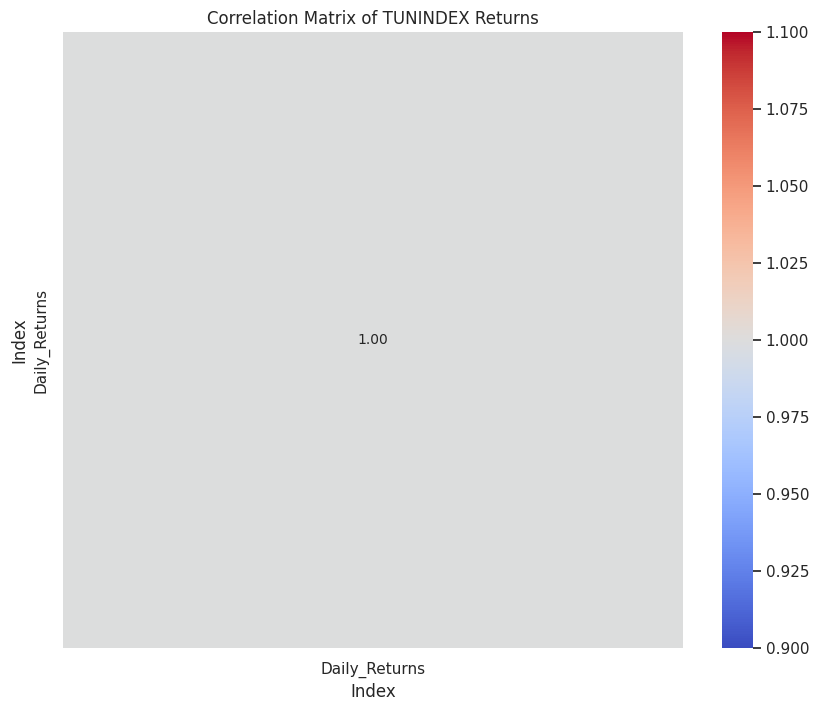

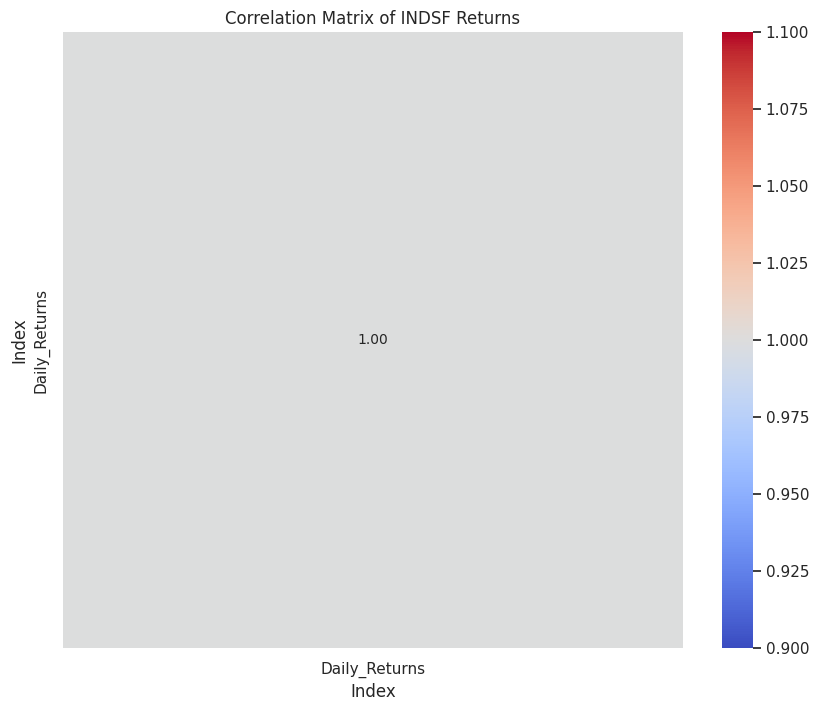

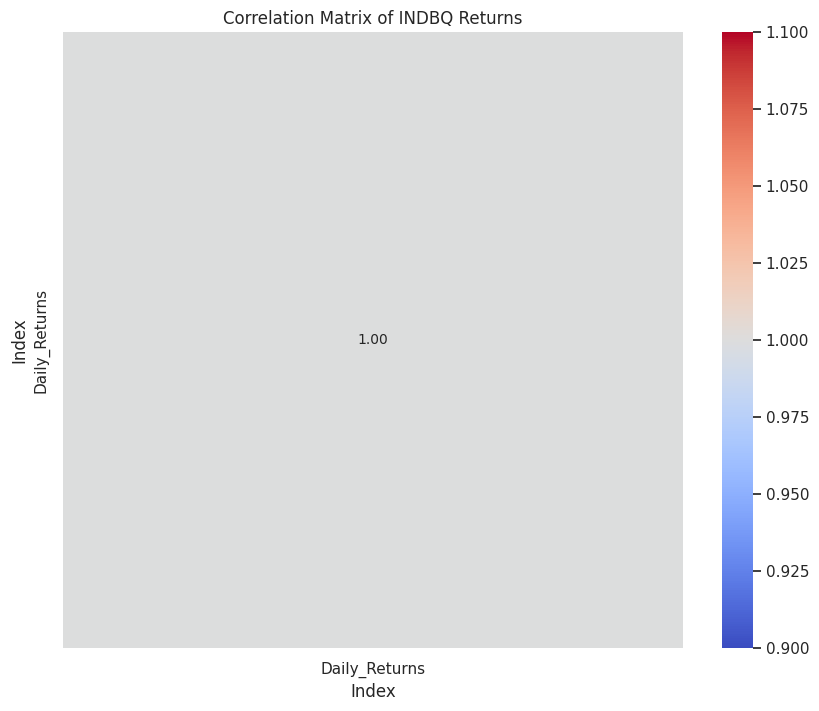

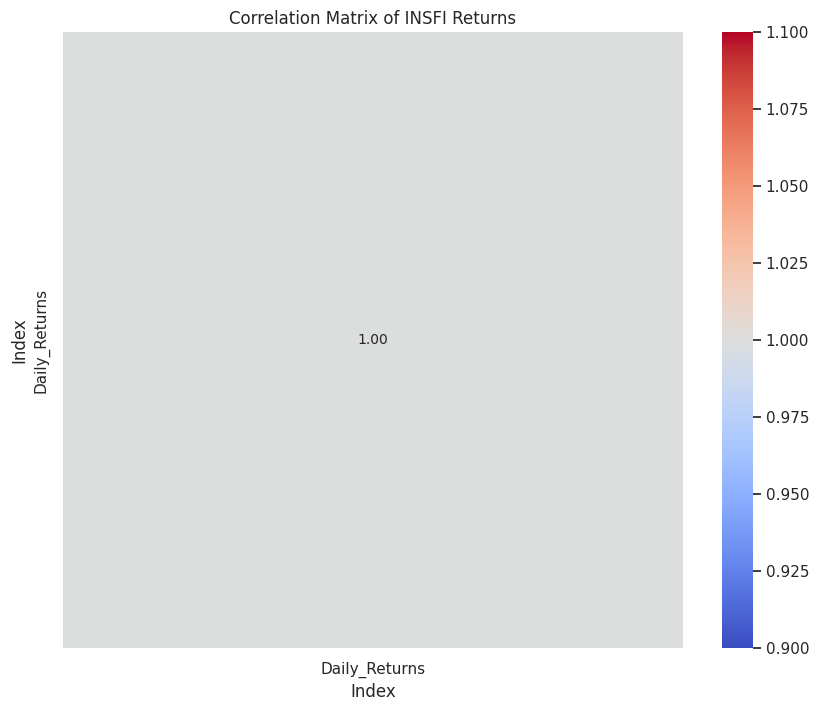

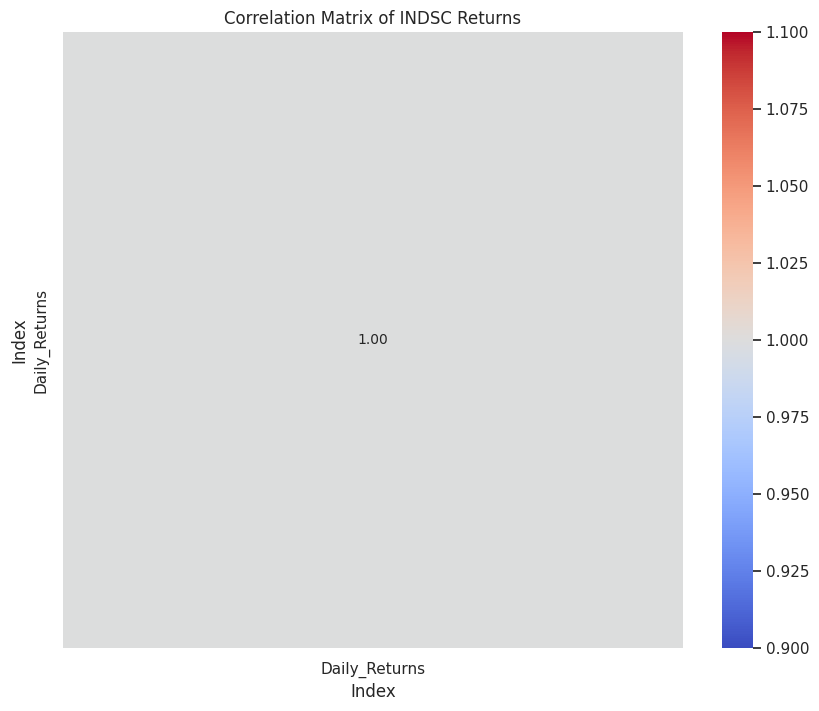

...

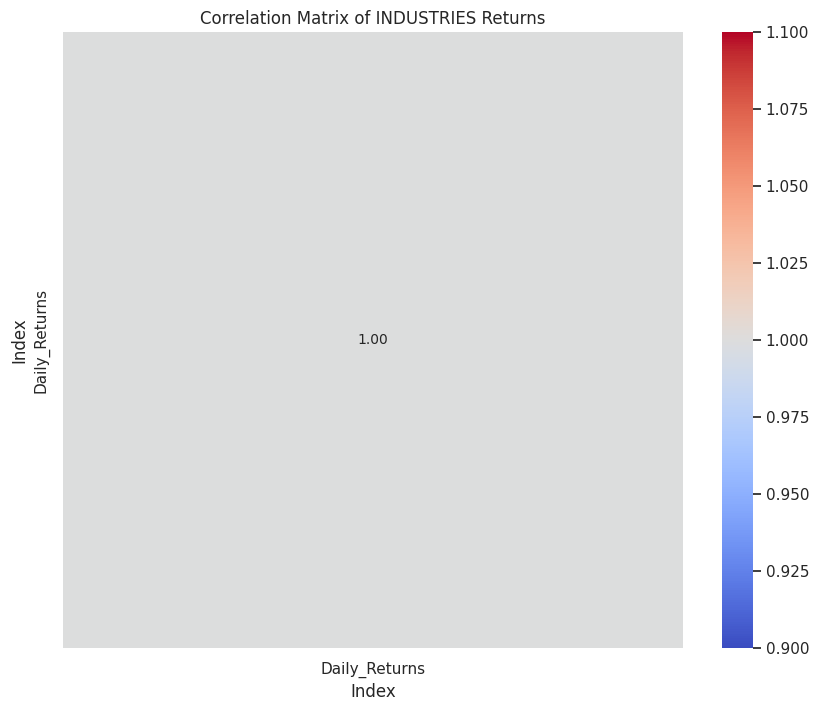

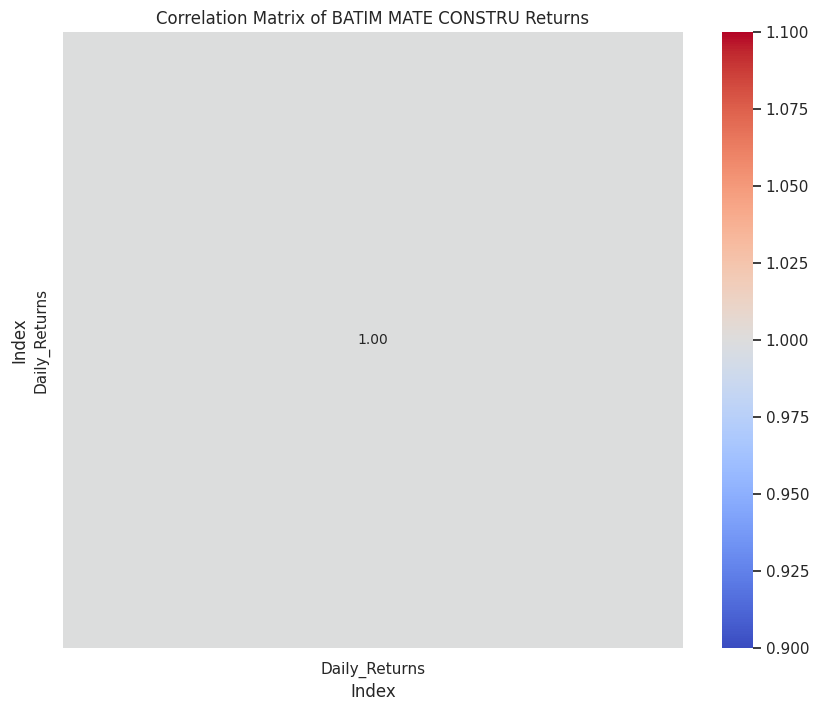

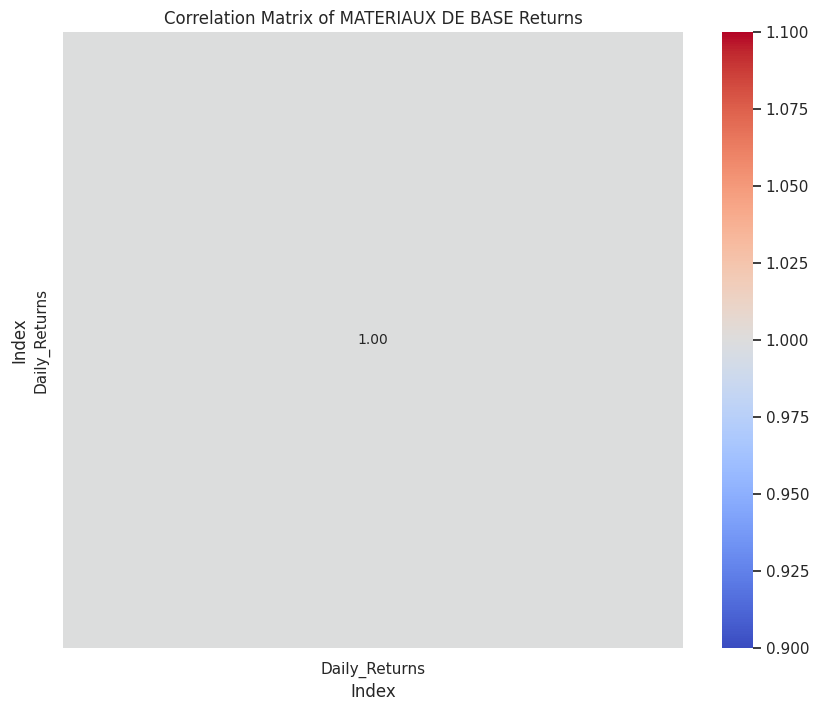

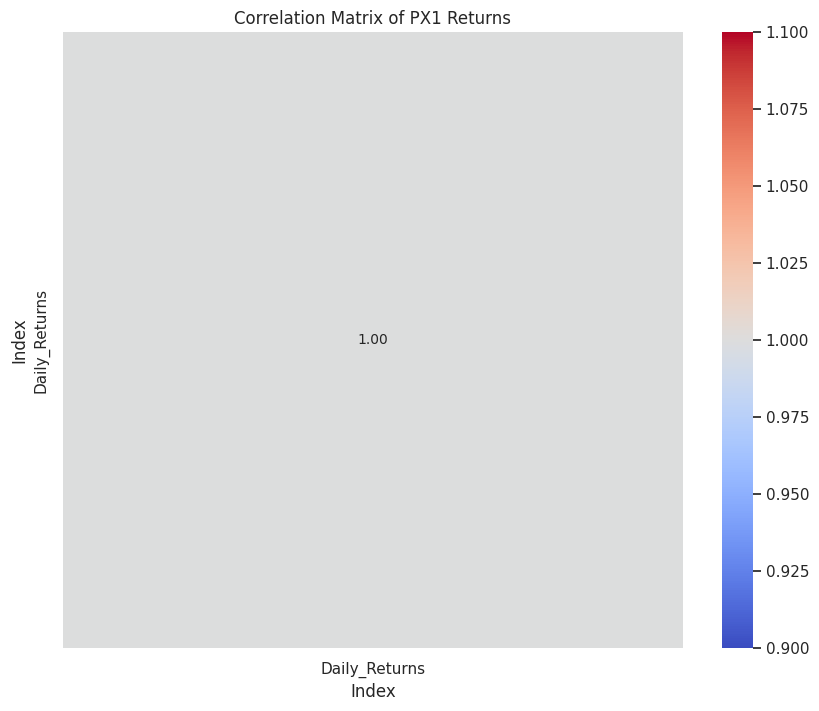

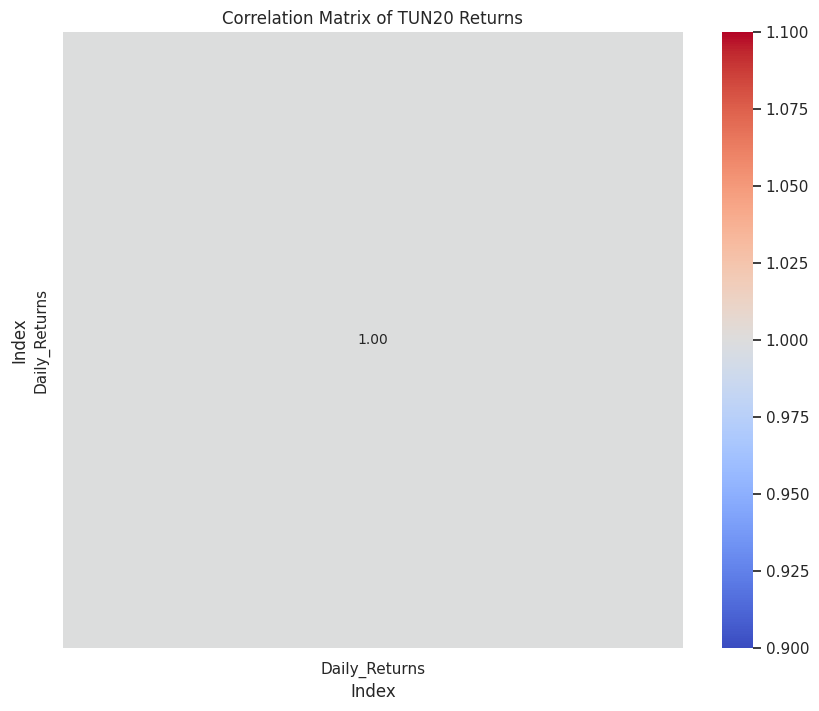

In [ ]:
import seaborn as sns

# Initialize an empty dictionary to store correlation matrices for each index
correlation_matrices = {}

# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Calculate index returns for the current index
    index_returns = dataframe[['Daily_Returns']]  # Select only the Daily_Returns column for now

    # Calculate correlation matrix
    correlation_matrix = index_returns.corr()

    # Store correlation matrix in the correlation_matrices dictionary
    correlation_matrices[index_name] = correlation_matrix

# Plot correlation matrix for each index
for index_name, correlation_matrix in correlation_matrices.items():
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
    plt.title(f'Correlation Matrix of {index_name} Returns')
    plt.xlabel('Index')
    plt.ylabel('Index')
    plt.show()


Sector Rotation Visualization:
Analyze sector performance over time and identify sectors that outperform or underperform the market.
Plot sector rotation charts or relative strength charts to visualize sector trends and rotations.

In [ ]:
# Assuming you have sector data for each index in your index_dataframes dictionary
# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Assuming you have sector data for the current index
    sector_data = get_sector_data(index_name)

    # Calculate sector returns
    sector_returns = sector_data.pivot_table(values='Daily_Returns', index='Date', columns='Sector')
    sector_performance = sector_returns.cumsum()

    # Plot sector rotation chart
    plt.figure(figsize=(12, 6))
    for sector in sector_performance.columns:
        plt.plot(sector_performance.index, sector_performance[sector], label=sector)

    plt.title(f'Sector Rotation Chart for {index_name}')
    plt.xlabel('Date')
    plt.ylabel('Cumulative Returns')
    plt.legend(loc='upper left')
    plt.grid(True)
    plt.show()


Fundamental Data Trends Visualization:
Plot fundamental data trends such as dividend yields, earnings growth rates, and economic indicators over time.
Identify trends, anomalies, or inflection points in fundamental data that may influence portfolio allocation decisions.

In [ ]:
# Assuming you have dividend yield data for each index in your index_dataframes dictionary
# Loop over each index in the index_dataframes dictionary
for index_name, dataframe in index_dataframes.items():
    # Assuming you have dividend yield data for the current index
    dividend_yield_data = get_dividend_yield_data(index_name)

    # Plot dividend yields over time for the current index
    plt.figure(figsize=(12, 6))
    plt.plot(dividend_yield_data['Date'], dividend_yield_data['Dividend_Yield'], label='Dividend Yield', color='blue')
    plt.title(f'Dividend Yield Over Time for {index_name}')
    plt.xlabel('Date')
    plt.ylabel('Dividend Yield')
    plt.legend()
    plt.grid(True)
    plt.show()


Integration and Analysis:
Integrate visualizations of index correlations, sector rotation, and fundamental data trends to identify diversification opportunities and optimize portfolio allocation.
Look for sectors or asset classes with low correlations to the overall market, strong performance trends, and favorable fundamental indicators for potential allocation.

In [ ]:
# Example: Combine visualizations to identify diversification opportunities
# Identify sectors with low correlations to the market, strong performance trends, and attractive fundamental metrics for portfolio allocation


By visualizing index correlations, sector rotation, and fundamental data trends together, investors can gain a comprehensive understanding of market dynamics and make informed decisions regarding portfolio diversification and allocation. Adjustments and refinements can be made based on evolving market conditions and investment objectives.